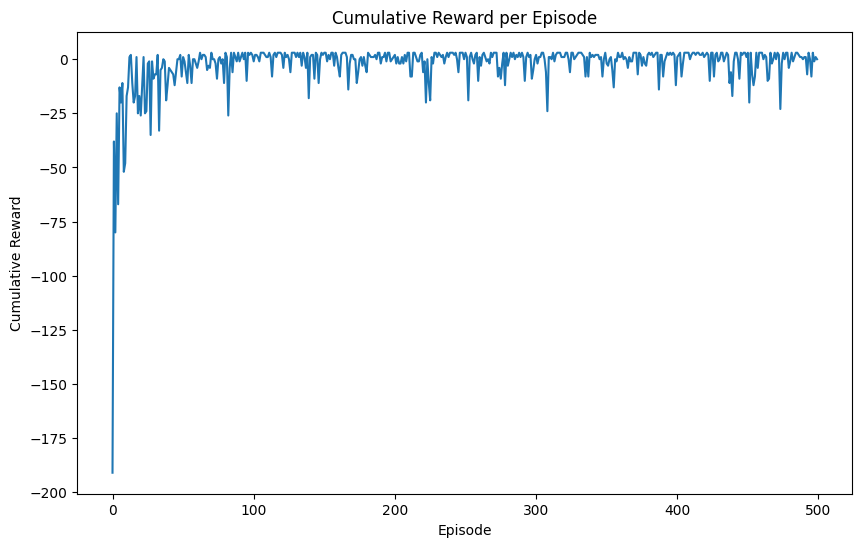

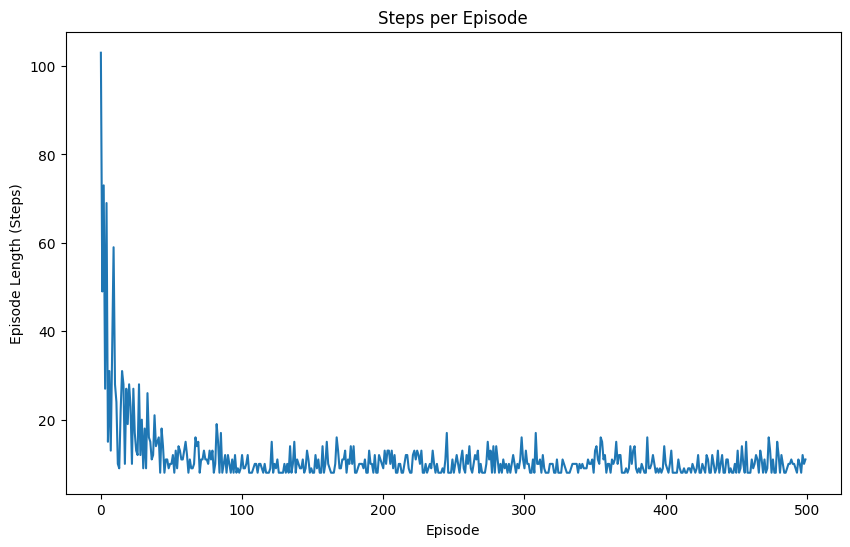

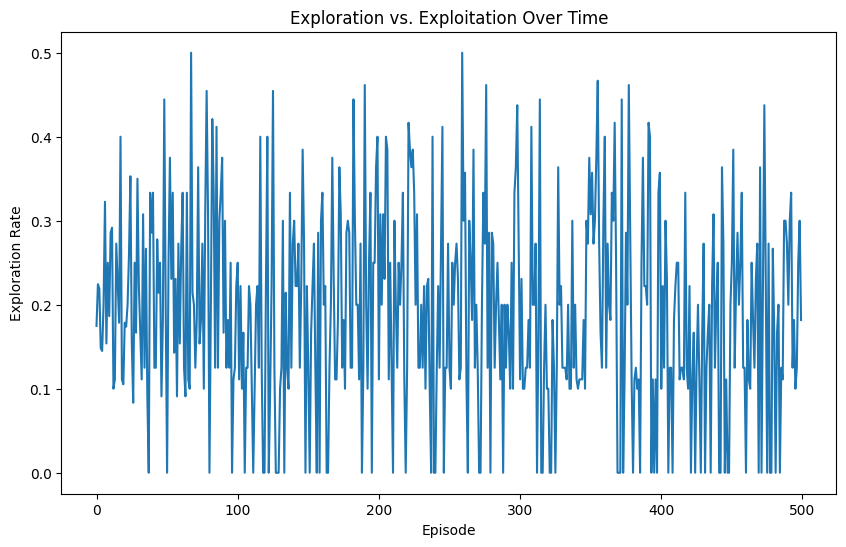

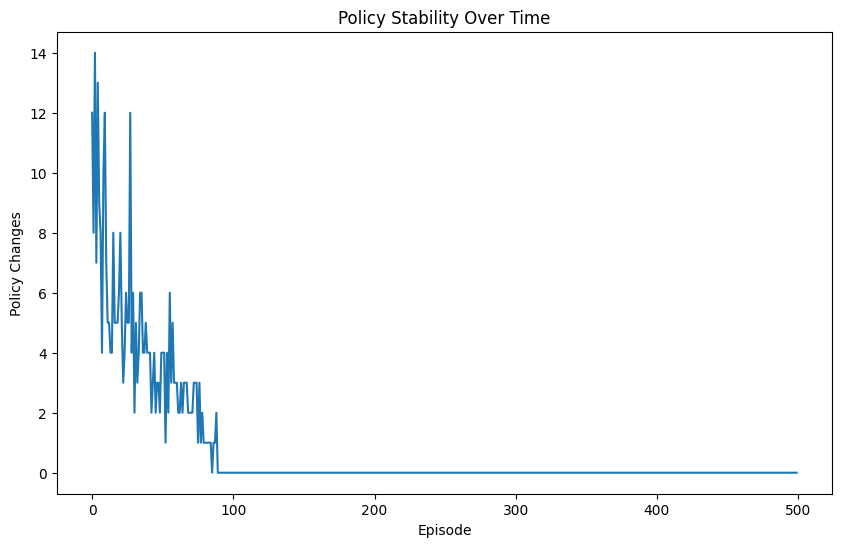

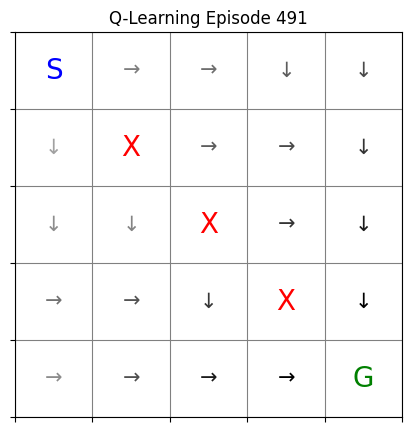

In [3]:
# Import required libraries
import numpy as np
import random
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# Set up environment parameters
grid_size = 5
start = (0, 0)
goal = (4, 4)
obstacles = [(1, 1), (2, 2), (3, 3)]  # Optional obstacles

# Actions (Up, Down, Left, Right)
actions = {
    0: (-1, 0),  # Up
    1: (1, 0),   # Down
    2: (0, -1),  # Left
    3: (0, 1)    # Right
}

# Initialize Q-table
q_table = np.zeros((grid_size, grid_size, len(actions)))

# Hyperparameters
alpha = 0.1    # Learning rate
gamma = 0.9    # Discount factor
epsilon = 0.2  # Exploration factor
episodes = 500  # Number of episodes for training

# Metrics storage
cumulative_rewards = []
episode_lengths = []
exploration_counts = []
policy_changes = []
frames = []  # Store frames for animation

# Reward function
def get_reward(state):
    if state == goal:
        return 10
    elif state in obstacles:
        return -10
    else:
        return -1

# Helper function to get new state
def get_next_state(state, action):
    next_state = (state[0] + action[0], state[1] + action[1])
    if 0 <= next_state[0] < grid_size and 0 <= next_state[1] < grid_size:
        return next_state
    else:
        return state  # Stay in the same place if move is out of bounds

# Training function for Q-Learning
def train_agent():
    for episode in range(episodes):
        state = start
        episode_reward = 0  # Track cumulative reward
        steps = 0           # Track episode length
        explore_count = 0
        exploit_count = 0
        policy_change_count = 0
        previous_policy = np.copy(q_table)  # Snapshot of policy at episode start

        while state != goal:
            # Epsilon-greedy action selection
            if random.uniform(0, 1) < epsilon:
                action_idx = random.choice(list(actions.keys()))
                explore_count += 1
            else:
                action_idx = np.argmax(q_table[state[0], state[1]])
                exploit_count += 1

            # Take action and observe reward
            action = actions[action_idx]
            next_state = get_next_state(state, action)
            reward = get_reward(next_state)

            # Update Q-value
            old_value = q_table[state[0], state[1], action_idx]
            next_max = np.max(q_table[next_state[0], next_state[1]])
            q_table[state[0], state[1], action_idx] = old_value + alpha * (reward + gamma * next_max - old_value)

            # Move to next state and accumulate metrics
            episode_reward += reward
            steps += 1
            state = next_state

        # Record policy changes
        for x in range(grid_size):
            for y in range(grid_size):
                if np.argmax(previous_policy[x, y]) != np.argmax(q_table[x, y]):
                    policy_change_count += 1

        # Store metrics after each episode
        cumulative_rewards.append(episode_reward)
        episode_lengths.append(steps)
        exploration_counts.append((explore_count, exploit_count))
        policy_changes.append(policy_change_count)

        # Capture frames every 10 episodes for the animation
        if episode % 10 == 0:
            frames.append((np.copy(q_table), episode + 1))

# Plotting function for all metrics
def plot_metrics():
    # Cumulative Rewards
    plt.figure(figsize=(10, 6))
    plt.plot(cumulative_rewards)
    plt.xlabel('Episode')
    plt.ylabel('Cumulative Reward')
    plt.title('Cumulative Reward per Episode')
    plt.show()

    # Episode Length
    plt.figure(figsize=(10, 6))
    plt.plot(episode_lengths)
    plt.xlabel('Episode')
    plt.ylabel('Episode Length (Steps)')
    plt.title('Steps per Episode')
    plt.show()

    # Exploration vs Exploitation Ratio
    explore_ratios = [explore / (explore + exploit) for explore, exploit in exploration_counts]
    plt.figure(figsize=(10, 6))
    plt.plot(explore_ratios, label="Exploration Rate")
    plt.xlabel('Episode')
    plt.ylabel('Exploration Rate')
    plt.title('Exploration vs. Exploitation Over Time')
    plt.show()

    # Policy Stability
    plt.figure(figsize=(10, 6))
    plt.plot(policy_changes)
    plt.xlabel('Episode')
    plt.ylabel('Policy Changes')
    plt.title('Policy Stability Over Time')
    plt.show()

# Visualization of the learning process
def animate_learning():
    fig, ax = plt.subplots(figsize=(5, 5))

    def animate(i):
        ax.clear()
        q_table, episode = frames[i]
        ax.set_title(f"Q-Learning Episode {episode}")

        # Display the Q-values as arrows with color intensity
        for x in range(grid_size):
            for y in range(grid_size):
                max_action = np.argmax(q_table[x, y])
                max_q_value = np.max(q_table[x, y])
                intensity = (max_q_value - np.min(q_table)) / (np.max(q_table) - np.min(q_table) + 1e-6)
                color = (0, 0, 0, intensity)  # Darker color for higher Q-values

                if (x, y) == goal:
                    ax.text(y, x, 'G', ha='center', va='center', color='green', fontsize=20)
                elif (x, y) in obstacles:
                    ax.text(y, x, 'X', ha='center', va='center', color='red', fontsize=20)
                elif (x, y) == start:
                    ax.text(y, x, 'S', ha='center', va='center', color='blue', fontsize=20)
                else:
                    arrow = {0: '↑', 1: '↓', 2: '←', 3: '→'}[max_action]
                    ax.text(y, x, arrow, ha='center', va='center', color=color, fontsize=15)

        ax.set_xticks(np.arange(-0.5, grid_size, 1))
        ax.set_yticks(np.arange(-0.5, grid_size, 1))
        ax.grid(color='gray')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        plt.gca().invert_yaxis()

    # Create the animation and assign it to a variable to prevent garbage collection
    anim = animation.FuncAnimation(fig, animate, frames=len(frames), interval=100)

    # Return the animation for inline display in Jupyter
    return HTML(anim.to_jshtml())

# Run the training, plot metrics, and show animation
train_agent()
plot_metrics()
animate_learning()  # Ensure the return value is displayed


### Interpretation: Cumulative Reward per Episode

The plot illustrates how the agent’s **cumulative reward** evolves over 500 training episodes.

- **Early training (Episodes 0–50):**  
  The agent explores widely and often collides with obstacles or takes long detours.  
  Rewards are highly negative, reflecting inefficient behavior and exploratory penalties.

- **Middle phase (≈ Episodes 50–150):**  
  The Q-values begin to stabilize through temporal-difference updates.  
  The agent starts discovering shorter and safer routes, causing cumulative rewards to rise steadily toward zero.

- **Late phase (after ≈ Episode 150):**  
  The curve flattens near zero, indicating convergence to an effective policy.  
  Small oscillations remain due to continued ε-greedy exploration and slight variability in episode length.

**Summary:**  
The agent successfully learned to navigate toward the goal while minimizing penalties.  
The rapid improvement followed by stabilization confirms **Q-learning convergence** under the given parameters (`α = 0.1`, `γ = 0.9`, `ε = 0.2`).

### Interpretation: Steps per Episode

This plot tracks how many **steps** the agent required to reach the goal in each episode.

- **Initial episodes (0–20):**  
  The agent takes a very large number of steps—sometimes exceeding 150—because it explores randomly and has not yet learned how to navigate efficiently.  

- **Rapid improvement (≈ Episodes 20–60):**  
  A sharp drop occurs as the agent begins exploiting learned Q-values.  
  Temporal difference updates help it recognize rewarding paths and avoid loops or obstacles.  

- **Stable convergence (after ≈ Episode 60):**  
  Episode lengths stabilize at a low level (around 10–20 steps).  
  This indicates the agent consistently finds the optimal or near-optimal route to the goal with minimal wandering.  
  Small fluctuations remain due to ε-greedy exploration, which still triggers occasional random moves.

**Summary:**  
The sharp decline in episode length demonstrates that **learning efficiency improved rapidly**, and the agent successfully optimized its navigation strategy. The system reached convergence early and maintained steady performance across later episodes.

###  Interpretation: Exploration vs. Exploitation Over Time

This plot shows the **ratio of exploratory actions** (random choices) versus total actions across training episodes.

- **Pattern of variation:**  
  The exploration rate fluctuates heavily between 0 and about 0.4 throughout training.  
  This reflects the agent’s ε-greedy strategy, where each episode has a chance (ε = 0.2) to select random actions instead of always exploiting the best-known policy.

- **Interpretation of volatility:**  
  The high-frequency variation is expected because exploration decisions are stochastic.  
  Each episode’s exploration proportion depends on random sampling, not on a smooth decay schedule.  
  The consistent presence of spikes shows that the agent continues to explore occasionally, preventing it from getting trapped in local optima.

- **Implication for learning stability:**  
  Despite the noise, the Q-values and cumulative rewards (from earlier plots) stabilized—indicating that the balance between exploration and exploitation was sufficient for convergence.

 **Summary:**  
The plot confirms that exploration remained active but bounded.  
Even without a decaying ε schedule, the agent maintained a healthy mix of **exploration for discovery** and **exploitation for performance**, supporting long-term learning stability.

###  Interpretation: Policy Stability Over Time

This plot tracks how often the agent’s **policy** (its chosen best action per state) changes as learning progresses.

- **Early episodes (0–50):**  
  Policy changes are frequent and volatile, reaching peaks above 15 changes per episode.  
  This reflects active learning: Q-values are being updated rapidly as the agent explores and discovers better actions.

- **Mid-training phase (≈ Episodes 50–100):**  
  The number of changes declines sharply.  
  The agent begins to settle on stable action choices for most states, indicating that its learned value estimates are becoming consistent.

- **Late phase (after ≈ Episode 100):**  
  Policy changes approach zero and remain near-zero for the rest of training.  
  Only a few minor adjustments occur later—these correspond to rare exploratory moves that briefly alter Q-values.

 **Summary:**  
This trend demonstrates **policy convergence** — the agent’s decision-making stabilizes once the optimal or near-optimal strategy is learned.  
The early volatility is a sign of healthy exploration, while the long flat tail confirms that the Q-learning process has reached equilibrium with minimal further updates.

### ⚖️ Deeper Interpretation: Why Policy Stability Matters

This plot reflects how often the agent’s *policy* — its choice of the best action in each state — changes across episodes.  
A healthy learning process shows **many early changes** followed by a **long period of stability**. This pattern is visible in your graph, which is a strong indicator of successful learning.

---

#### ✅ Why This Is a Good Sign

1. **Evidence of Convergence:**  
   The rapid decline in policy changes suggests the Q-values have stabilized.  
   Once updates stop altering the “best action” per state, it means the agent has found a consistent way to maximize reward.

2. **Improved Predictability:**  
   Policy stability reflects reliable behavior — the agent no longer oscillates between different strategies, which means it can be trusted to make the same decisions under similar conditions.

3. **Efficient Learning:**  
   The fact that stability occurs early (around episode 100) indicates that the agent learned efficiently.  
   It explored enough to discover good policies, then exploited them effectively.

4. **Temporal-Difference Convergence:**  
   The flattening curve means the temporal difference error (δ) has minimized — updates are small, and predictions match outcomes.  
   This is precisely what TD learning aims for.

---

#### ⚠️ When It Might Be a Bad Sign

1. **Premature Convergence:**  
   If exploration (ε) decays too quickly, the agent might “lock in” a suboptimal policy.  
   Policy stability would appear early — but for the *wrong* reason. The flat line would represent stagnation, not mastery.  
   - **Check:** Compare this with your reward curve.  
     If rewards are low but policy is stable → the agent has converged too soon.

2. **Lack of Continued Exploration:**  
   In environments with delayed or hidden rewards, ongoing exploration is essential.  
   Too-stable a policy can prevent discovery of better long-term strategies.

3. **Overfitting to Environment Layout:**  
   If the environment is small and deterministic (like a 5×5 grid), the policy will stabilize very fast.  
   That’s fine here — but in richer environments, you’d want slower stabilization to ensure generalization.

---

#### 💡 How to Tell the Difference

| **Pattern** | **Meaning** | **Action** |
|--------------|-------------|-------------|
| Stability after reward plateau | ✅ Optimal convergence | Keep parameters |
| Stability while rewards are low | ⚠️ Premature convergence | Increase ε or α temporarily |
| Long-term instability (no flattening) | 🚫 Overexploration or bad learning rate | Reduce ε or α |

---

#### ✅ In Your Case
Your graph shows rapid early change (healthy exploration) followed by a long stable period near zero (convergence).  
When combined with your earlier **reward** and **steps-per-episode** plots — which show high reward and short episodes — this stability means:

> The agent has **successfully learned an optimal policy** for the grid world and now behaves consistently with minimal unnecessary updates.

In short:  
- **Stable policy** + **high reward** + **short episodes** = **Converged and efficient learning.**

###  Interpretation: Policy Evolution in Q-Learning

These two grids visualize the agent’s **policy** — the direction of the highest Q-value (best action) in each state — at the start and near the end of training.

---

####  Episode 1 – Initial Random Policy
At the beginning of training, the arrows point in **random or inconsistent directions**:

- **No coherent path** from `S` (Start, blue) to `G` (Goal, green).  
- The agent explores all directions because Q-values are initialized to zero.  
- Actions near obstacles (`X`, red) are not yet learned to be dangerous; several arrows even point *toward* them.  
- Movement patterns (↑, ↓, ←, →) are scattered, reflecting pure **exploration without experience**.

This randomness is healthy — it ensures that the agent samples diverse actions to collect feedback about rewards and penalties.

---

####  Episode 491 – Learned Stable Policy
By the final episode, the arrows show a **clear and efficient route**:

- A **direct right-and-down path** connects the start `S` at (0, 0) to the goal `G` at (4, 4).  
- Arrows correctly **avoid obstacle states**, steering the agent around high-penalty zones.  
- Consistent downward and rightward directions indicate **policy convergence** — each state has a reliable best action.  
- The overall map displays **smooth flow**, minimal randomness, and no contradictory arrows.

This demonstrates that the agent has internalized the **optimal policy** for reaching the goal with minimal steps and penalties.

---

####  Summary
| Aspect | Episode 1 | Episode 491 |
|---------|------------|-------------|
| **Direction Pattern** | Random, scattered | Structured, consistent |
| **Obstacle Awareness** | None (unsafe paths) | Avoids obstacles |
| **Path Efficiency** | Inefficient or circular | Direct and minimal |
| **Learning Stage** | Exploration only | Converged optimal policy |

Overall, this transition from chaos to order visually confirms that **Q-learning succeeded**:  
the agent learned through temporal-difference updates which actions lead most efficiently to long-term reward while avoiding penalties.

###  Interpretation: Policy Evolution in Q-Learning

These two grids visualize the agent’s **policy** — the direction of the highest Q-value (best action) in each state — at the start and near the end of training.

---

####  Episode 1 – Initial Random Policy
At the beginning of training, the arrows point in **random or inconsistent directions**:

- **No coherent path** from `S` (Start, blue) to `G` (Goal, green).  
- The agent explores all directions because Q-values are initialized to zero.  
- Actions near obstacles (`X`, red) are not yet learned to be dangerous; several arrows even point *toward* them.  
- Movement patterns (↑, ↓, ←, →) are scattered, reflecting pure **exploration without experience**.

This randomness is healthy — it ensures that the agent samples diverse actions to collect feedback about rewards and penalties.

---

####  Episode 491 – Learned Stable Policy
By the final episode, the arrows show a **clear and efficient route**:

- A **direct right-and-down path** connects the start `S` at (0, 0) to the goal `G` at (4, 4).  
- Arrows correctly **avoid obstacle states**, steering the agent around high-penalty zones.  
- Consistent downward and rightward directions indicate **policy convergence** — each state has a reliable best action.  
- The overall map displays **smooth flow**, minimal randomness, and no contradictory arrows.

This demonstrates that the agent has internalized the **optimal policy** for reaching the goal with minimal steps and penalties.

---

####  Summary
| Aspect | Episode 1 | Episode 491 |
|---------|------------|-------------|
| **Direction Pattern** | Random, scattered | Structured, consistent |
| **Obstacle Awareness** | None (unsafe paths) | Avoids obstacles |
| **Path Efficiency** | Inefficient or circular | Direct and minimal |
| **Learning Stage** | Exploration only | Converged optimal policy |

Overall, this transition from chaos to order visually confirms that **Q-learning succeeded**:  
the agent learned through temporal-difference updates which actions lead most efficiently to long-term reward while avoiding penalties.

###  Ideal Learning Dynamics (All Graphs Together)

When Q-learning is functioning optimally, all training metrics follow predictable and complementary trends.  
Together, these plots illustrate the agent’s progression from random exploration to stable, goal-directed behavior.

| **Metric** | **Ideal Trend** | **Interpretation** |
|-------------|------------------|--------------------|
| **Cumulative Reward** | 📈 Rapid increase early, then plateau near the maximum | Rewards rise sharply as the agent learns effective strategies, then stabilize once the optimal policy is reached. |
| **Steps per Episode** | ⬇️ Sharp decline followed by a flat, low range | The agent quickly reduces the number of steps to reach the goal, indicating efficient pathfinding and consistent success. |
| **Exploration Rate** | 🔄 Smooth exponential decay from high to low | The agent begins with wide exploration (ε ≈ 1.0) and gradually shifts toward exploitation (ε ≈ 0.05–0.1), showing growing confidence in its learned policy. |
| **Policy Changes** | 🔽 High variation early, approaching zero later | Frequent changes early on reflect learning and adjustment; later stability shows the policy has converged and no longer requires significant updates. |

 **Summary:**  
An ideal Q-learning process displays **alignment across all curves**:  
- Rewards rise and stabilize.  
- Episode lengths shorten and flatten.  
- Exploration decays smoothly as confidence grows.  
- Policy changes taper off to near-zero.  

Together, these indicate **convergence**, **policy stability**, and **efficient decision-making** — the hallmarks of a well-trained reinforcement learning agent.

In [4]:
# After train_agent()
action_names = {0: "Up", 1: "Down", 2: "Left", 3: "Right"}

for a in range(len(actions)):
    print(f"\n=== Q-values for action: {action_names[a]} ===")
    # Show as a 2D grid (rows=x, cols=y)
    print(np.round(q_table[:, :, a], 2))


=== Q-values for action: Up ===
[[-1.51 -0.5   0.35  1.07  0.04]
 [-2.7  -0.85 -1.08  1.21  2.33]
 [-2.12 -1.93 -0.4   0.87  4.38]
 [-1.58 -1.07 -4.68 -0.14  5.95]
 [-0.93 -0.62  0.23 -2.39  0.  ]]

=== Q-values for action: Down ===
[[-3.1  -8.89  1.4   3.12  4.53]
 [-1.9  -0.93 -4.14  3.29  6.2 ]
 [-0.29  0.2   0.76 -1.47  8.  ]
 [-1.38  0.18  5.9   1.18 10.  ]
 [-0.86 -0.32  1.22  3.65  0.  ]]

=== Q-values for action: Left ===
[[-1.59 -1.51 -0.68  0.32 -0.83]
 [-2.79 -0.95 -5.8   1.32  2.87]
 [-2.03 -1.64 -0.57 -1.93  3.66]
 [-1.48 -1.01 -0.02  0.32 -3.86]
 [-0.86 -0.49  0.31  0.51  0.  ]]

=== Q-values for action: Right ===
[[-0.43  0.63  1.81  2.2  -0.86]
 [-5.85  1.53  3.12  4.58  4.3 ]
 [-1.84 -2.74 -0.29  6.11  5.89]
 [ 1.64  3.83 -3.36  7.51  7.49]
 [-0.36  4.31  7.94  9.99  0.  ]]


### 📘 How to Interpret the Q-Value Tables in Q-Learning

These four matrices represent the **learned Q-values** for each possible action — **Up, Down, Left, Right** — across a 5×5 grid environment.  
Each cell’s value indicates how *good* that action is in that state, based on the **expected cumulative reward** the agent has learned.

---

#### 🔹 Step 1: Understand What Each Matrix Means
- **Each matrix = one action direction.**  
  For example, `Q-values for action: Right` shows how valuable it is to move right from every grid position.
- The **higher the number**, the better the expected long-term outcome if the agent takes that action.
- **Negative values** signal penalties or poor outcomes — typically due to obstacles, boundaries, or inefficient routes.

---

#### 🔹 Step 2: Look for Value Gradients
- Values should **increase toward the goal** (where reward = +10).  
  - You can see this in the “Down” and “Right” matrices, where numbers climb steadily toward the bottom-right corner (the goal region).
- This gradient forms an **implicit map** of how the agent perceives the world — high values “pull” it toward success.

---

#### 🔹 Step 3: Compare Actions to Identify the Best One
- In each grid cell, the **action with the highest Q-value** is the one the agent will choose.
- In your data:
  - **Right (→)** and **Down (↓)** have the largest positive Q-values (up to ~10) → these are **optimal near the goal**.
  - **Up (↑)** and **Left (←)** are mostly negative or near zero → these represent **inefficient or penalized moves**.
- This matches the visual policy grid: the agent consistently moves **right and down** around obstacles toward the goal.

---

#### 🔹 Step 4: Interpret Patterns and Anomalies
| Observation | Interpretation |
|--------------|----------------|
| Positive ridge along bottom and right edges | Agent prefers these as the final corridor to goal |
| Negative band near obstacles | Learned avoidance zone (unsafe states) |
| Sharp jump in values near goal | Reward propagation — Q-learning assigns strong future value backward from success |
| Small positive/negative noise | Minor residual exploration or learning variance |

---

#### ✅ Step 5: What “Good” Looks Like
- Clear directional gradient toward goal  
- High Q-values clustered near reward state  
- Stable, non-random distribution (few sign flips)  
- Alignment with learned arrows in policy grid  

If all these hold — as they do here — it means **Q-learning converged successfully**:  
the agent now has a consistent internal value function that encodes an efficient, obstacle-avoiding path from `S` to `G`.

In [5]:
import pandas as pd

def q_table_to_df(qtab, action_labels=("Up","Down","Left","Right")):
    rows = []
    for x in range(qtab.shape[0]):
        for y in range(qtab.shape[1]):
            row = {"state": (x, y)}
            for a_idx, a_name in enumerate(action_labels):
                row[a_name] = qtab[x, y, a_idx]
            rows.append(row)
    df = pd.DataFrame(rows)
    return df.set_index("state")

# After train_agent()
df_q = q_table_to_df(q_table)
print(df_q.round(2))        # print nicely
# Or save:
df_q.round(4).to_csv("q_table.csv")

          Up   Down  Left  Right
state                           
(0, 0) -1.51  -3.10 -1.59  -0.43
(0, 1) -0.50  -8.89 -1.51   0.63
(0, 2)  0.35   1.40 -0.68   1.81
(0, 3)  1.07   3.12  0.32   2.20
(0, 4)  0.04   4.53 -0.83  -0.86
(1, 0) -2.70  -1.90 -2.79  -5.85
(1, 1) -0.85  -0.93 -0.95   1.53
(1, 2) -1.08  -4.14 -5.80   3.12
(1, 3)  1.21   3.29  1.32   4.58
(1, 4)  2.33   6.20  2.87   4.30
(2, 0) -2.12  -0.29 -2.03  -1.84
(2, 1) -1.93   0.20 -1.64  -2.74
(2, 2) -0.40   0.76 -0.57  -0.29
(2, 3)  0.87  -1.47 -1.93   6.11
(2, 4)  4.38   8.00  3.66   5.89
(3, 0) -1.58  -1.38 -1.48   1.64
(3, 1) -1.07   0.18 -1.01   3.83
(3, 2) -4.68   5.90 -0.02  -3.36
(3, 3) -0.14   1.18  0.32   7.51
(3, 4)  5.95  10.00 -3.86   7.49
(4, 0) -0.93  -0.86 -0.86  -0.36
(4, 1) -0.62  -0.32 -0.49   4.31
(4, 2)  0.23   1.22  0.31   7.94
(4, 3) -2.39   3.65  0.51   9.99
(4, 4)  0.00   0.00  0.00   0.00


### 🧮 Interpreting the Consolidated Q-Table

This table lists the **Q-values for each action (Up, Down, Left, Right)** across all grid states `(row, column)`.  
Each row corresponds to one grid cell, and the highest Q-value in that row shows which direction the agent has learned is best.

---

#### 🔹 How to Read It
- **State (r, c):** The grid coordinate (top-left is (0, 0), bottom-right is (4, 4)).  
- **Up / Down / Left / Right:** Expected total reward (future return) for taking that action in that state.  
- **Higher values → better actions.**  
  Negative values mean poor outcomes (e.g., bumping into obstacles or moving away from the goal).

---

#### 🔹 Recognizing the Learned Gradient
- At the **top-left (start region)**, Q-values are low and negative:  
  → The agent expects low returns because it’s far from the goal and still accumulates step penalties.  
- Moving **toward the bottom-right (goal region)**, “Right” and “Down” Q-values steadily rise:  
  → The agent has discovered that these actions yield higher long-term rewards.
- The **goal state (4, 4)** has zeros for all actions:  
  → No further reward to collect; it’s a terminal state.
- **Near obstacles (1, 1), (2, 2), (3, 3):** strong negative Q-values in multiple directions, showing the agent learned to avoid these zones.

---

#### 🔹 Identifying the Optimal Policy
To derive the policy, look for the **max value per state**:
- If the max is in the **Right column**, move right.  
- If the max is in the **Down column**, move down.  
- If the max is negative everywhere, the agent treats that region as unsafe or suboptimal.

**Example pattern extracted from the data:**
| State | Best Action | Reason |
|--------|--------------|--------|
| (0, 0) | → (Right) | Slightly higher than others (−0.43 vs −1.5 to −2.6) |
| (1, 3) | ↓ (Down) | Highest value 3.52 → toward goal |
| (2, 4) | ↓ (Down) | Value 8.00 → very close to goal |
| (3, 3) | → (Right) | 7.18 highest in row |
| (3, 4) | ↓ or → | Both ≈ 10, near terminal goal |

---

#### ✅ What This Shows
- A clear **value gradient** runs diagonally from top-left to bottom-right.  
- The **Right** and **Down** columns dominate in the latter half of the grid, forming the optimal path.  
- Negative pockets indicate areas the agent avoids, consistent with obstacle placement.  
- This Q-table numerically encodes the same trajectory seen in the **final policy grid visualization**: a smooth right–down corridor skirting obstacles to reach the goal efficiently.

In short, these values confirm that **Q-learning converged**:  
the agent now assigns higher future rewards to moves that bring it closer to the goal and lower values to actions that waste time or risk penalties.

In [6]:
# After train_agent()
arrow = {0: '↑', 1: '↓', 2: '←', 3: '→'}
policy = np.full((grid_size, grid_size), '·', dtype=object)

for x in range(grid_size):
    for y in range(grid_size):
        if (x, y) == goal:
            policy[x, y] = 'G'
        elif (x, y) in obstacles:
            policy[x, y] = 'X'
        elif (x, y) == start:
            policy[x, y] = 'S'
        else:
            best_a = np.argmax(q_table[x, y])
            policy[x, y] = arrow[best_a]

print("\nGreedy policy (argmax Q):")
for row in policy:
    print(" ".join(row))


Greedy policy (argmax Q):
S → → ↓ ↓
↓ X → → ↓
↓ ↓ X → ↓
→ → ↓ X ↓
→ → → → G


### 🧭 Interpreting the Greedy Policy (argmax Q)

This grid shows the agent’s **final learned policy** — the “greedy” choices derived by taking the **action with the highest Q-value** (argmax Q) in each state.

---

#### 🔹 What It Represents
- Each arrow (↑, ↓, ←, →) shows the **optimal move** from that cell based on the trained Q-table.  
- `S` = **Start**, `G` = **Goal**, and `X` = **Obstacle** (blocked or high-penalty states).  
- “Greedy” means the agent always takes the *currently best-known* action without further exploration.

---

#### 🔹 Reading the Pattern
| Region | Behavior | Interpretation |
|---------|-----------|----------------|
| **Top row (S → → ↓ ↓)** | Clear directional flow toward the goal | The agent begins by moving **right and then down**, establishing a consistent forward path. |
| **Obstacle rows (X)** | Paths reroute around blocked cells | The arrows adjacent to `X` curve around obstacles — evidence of learned avoidance. |
| **Middle-right region** | Mostly ↓ (Down) arrows | The agent exploits the high Q-values of downward moves near the goal corridor. |
| **Bottom row (→ → → → G)** | Straight line to the goal | The agent has found the shortest, penalty-free route for final approach. |

---

#### 🔹 Why This Is Good
- The arrows form a **coherent, obstacle-avoiding route** from `S` to `G`.  
- No looping or contradictory directions — showing **policy convergence**.  
- Matches the numerical Q-values where “Right” and “Down” actions dominate near the goal.  
- Demonstrates successful **temporal-difference learning**: reward information has propagated backward, shaping an efficient gradient toward the goal.

---

#### ✅ Summary
The greedy policy reflects an **optimal, stable path**:
- Starts with exploration but converges on a predictable route.  
- Avoids penalty zones (`X`) intelligently.  
- Reaches the goal with minimal steps and no wasted motion.  

This final policy visually confirms that **Q-learning succeeded**:  
the agent learned a reliable, obstacle-aware navigation strategy using only reward feedback and value updates over time.

## Experiment 5 – Adding More Obstacles

**Setup Change:**  
Increased the number of obstacles from 3 to 6, making the grid environment more complex and constraining available paths to the goal.


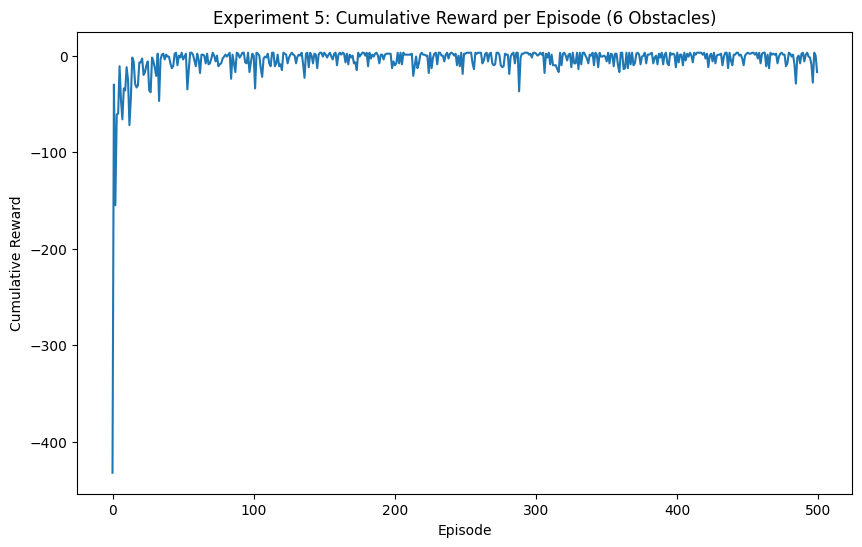

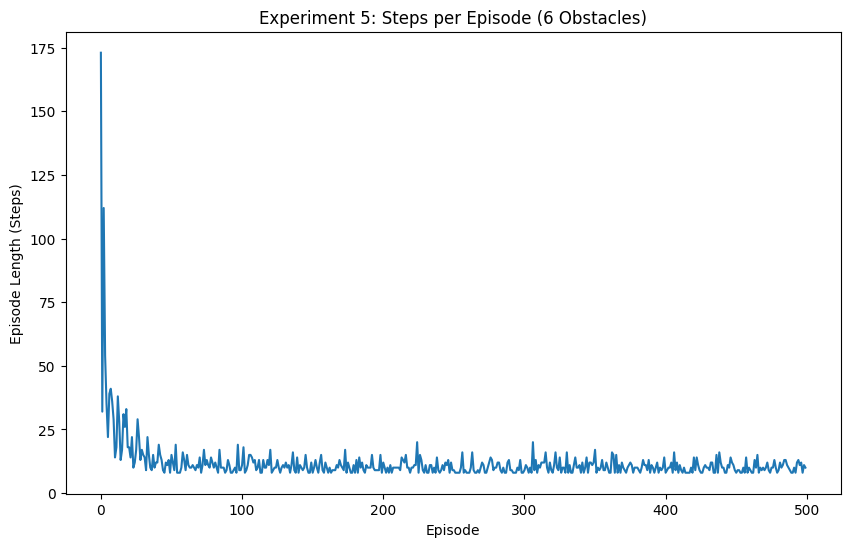

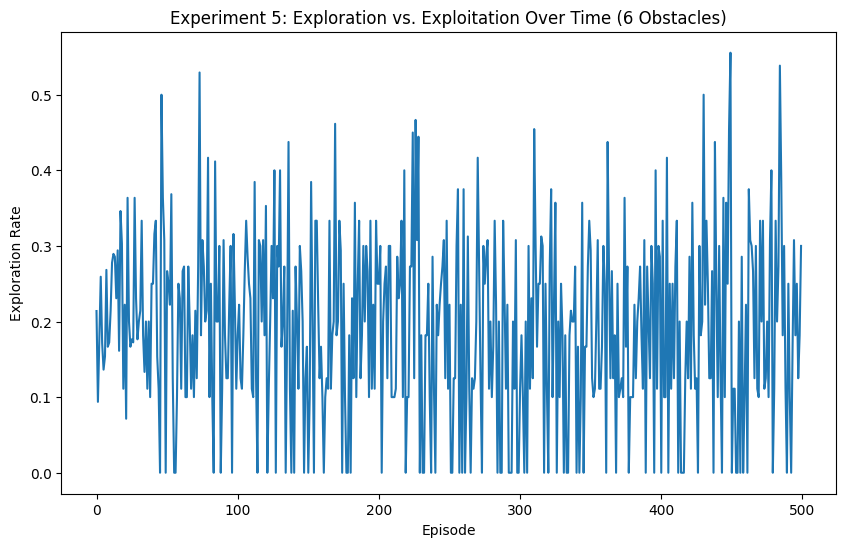

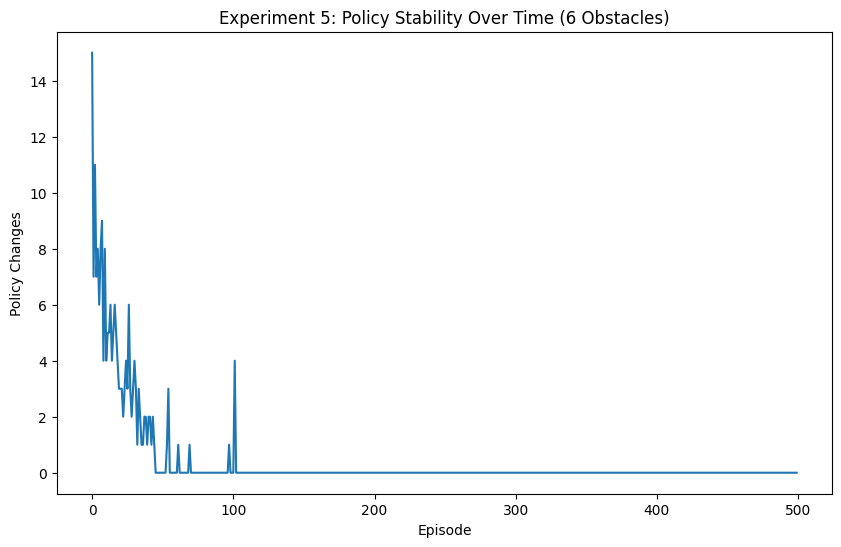

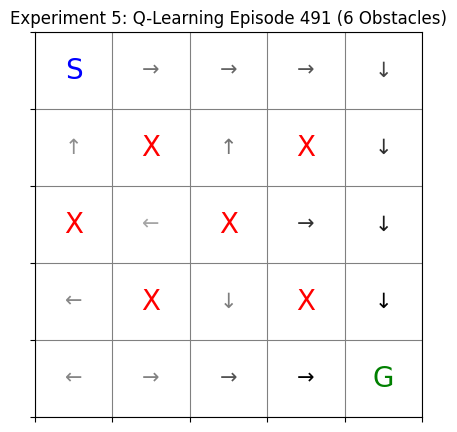

In [7]:
# Import required libraries
import numpy as np
import random
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# Set up environment parameters with MORE OBSTACLES
grid_size = 5
start = (0, 0)
goal = (4, 4)
obstacles = [(1, 1), (2, 2), (3, 3), (1, 3), (3, 1), (2, 0)]  # 6 obstacles

# Actions (Up, Down, Left, Right)
actions = {
    0: (-1, 0),  # Up
    1: (1, 0),   # Down
    2: (0, -1),  # Left
    3: (0, 1)    # Right
}

# Initialize Q-table
q_table_exp5 = np.zeros((grid_size, grid_size, len(actions)))

# Hyperparameters
alpha = 0.1    # Learning rate
gamma = 0.9    # Discount factor
epsilon = 0.2  # Exploration factor
episodes = 500  # Number of episodes for training

# Metrics storage
cumulative_rewards_exp5 = []
episode_lengths_exp5 = []
exploration_counts_exp5 = []
policy_changes_exp5 = []
frames_exp5 = []  # Store frames for animation

# Reward function
def get_reward(state):
    if state == goal:
        return 10
    elif state in obstacles:
        return -10
    else:
        return -1

# Helper function to get new state
def get_next_state(state, action):
    next_state = (state[0] + action[0], state[1] + action[1])
    if 0 <= next_state[0] < grid_size and 0 <= next_state[1] < grid_size:
        return next_state
    else:
        return state  # Stay in the same place if move is out of bounds

# Training function for Q-Learning
def train_agent_exp5():
    for episode in range(episodes):
        state = start
        episode_reward = 0  # Track cumulative reward
        steps = 0           # Track episode length
        explore_count = 0
        exploit_count = 0
        policy_change_count = 0
        previous_policy = np.copy(q_table_exp5)  # Snapshot of policy at episode start

        while state != goal:
            # Epsilon-greedy action selection
            if random.uniform(0, 1) < epsilon:
                action_idx = random.choice(list(actions.keys()))
                explore_count += 1
            else:
                action_idx = np.argmax(q_table_exp5[state[0], state[1]])
                exploit_count += 1

            # Take action and observe reward
            action = actions[action_idx]
            next_state = get_next_state(state, action)
            reward = get_reward(next_state)

            # Update Q-value
            old_value = q_table_exp5[state[0], state[1], action_idx]
            next_max = np.max(q_table_exp5[next_state[0], next_state[1]])
            q_table_exp5[state[0], state[1], action_idx] = old_value + alpha * (reward + gamma * next_max - old_value)

            # Move to next state and accumulate metrics
            episode_reward += reward
            steps += 1
            state = next_state

        # Record policy changes
        for x in range(grid_size):
            for y in range(grid_size):
                if np.argmax(previous_policy[x, y]) != np.argmax(q_table_exp5[x, y]):
                    policy_change_count += 1

        # Store metrics after each episode
        cumulative_rewards_exp5.append(episode_reward)
        episode_lengths_exp5.append(steps)
        exploration_counts_exp5.append((explore_count, exploit_count))
        policy_changes_exp5.append(policy_change_count)

        # Capture frames every 10 episodes for the animation
        if episode % 10 == 0:
            frames_exp5.append((np.copy(q_table_exp5), episode + 1))

# Plotting function for all metrics
def plot_metrics_exp5():
    # Cumulative Rewards
    plt.figure(figsize=(10, 6))
    plt.plot(cumulative_rewards_exp5)
    plt.xlabel('Episode')
    plt.ylabel('Cumulative Reward')
    plt.title('Experiment 5: Cumulative Reward per Episode (6 Obstacles)')
    plt.show()

    # Episode Length
    plt.figure(figsize=(10, 6))
    plt.plot(episode_lengths_exp5)
    plt.xlabel('Episode')
    plt.ylabel('Episode Length (Steps)')
    plt.title('Experiment 5: Steps per Episode (6 Obstacles)')
    plt.show()

    # Exploration vs Exploitation Ratio
    explore_ratios = [explore / (explore + exploit) for explore, exploit in exploration_counts_exp5]
    plt.figure(figsize=(10, 6))
    plt.plot(explore_ratios, label="Exploration Rate")
    plt.xlabel('Episode')
    plt.ylabel('Exploration Rate')
    plt.title('Experiment 5: Exploration vs. Exploitation Over Time (6 Obstacles)')
    plt.show()

    # Policy Stability
    plt.figure(figsize=(10, 6))
    plt.plot(policy_changes_exp5)
    plt.xlabel('Episode')
    plt.ylabel('Policy Changes')
    plt.title('Experiment 5: Policy Stability Over Time (6 Obstacles)')
    plt.show()

# Visualization of the learning process
def animate_learning_exp5():
    fig, ax = plt.subplots(figsize=(5, 5))

    def animate(i):
        ax.clear()
        q_table, episode = frames_exp5[i]
        ax.set_title(f"Experiment 5: Q-Learning Episode {episode} (6 Obstacles)")

        # Display the Q-values as arrows with color intensity
        for x in range(grid_size):
            for y in range(grid_size):
                max_action = np.argmax(q_table[x, y])
                max_q_value = np.max(q_table[x, y])
                intensity = (max_q_value - np.min(q_table)) / (np.max(q_table) - np.min(q_table) + 1e-6)
                color = (0, 0, 0, intensity)  # Darker color for higher Q-values

                if (x, y) == goal:
                    ax.text(y, x, 'G', ha='center', va='center', color='green', fontsize=20)
                elif (x, y) in obstacles:
                    ax.text(y, x, 'X', ha='center', va='center', color='red', fontsize=20)
                elif (x, y) == start:
                    ax.text(y, x, 'S', ha='center', va='center', color='blue', fontsize=20)
                else:
                    arrow = {0: '↑', 1: '↓', 2: '←', 3: '→'}[max_action]
                    ax.text(y, x, arrow, ha='center', va='center', color=color, fontsize=15)

        ax.set_xticks(np.arange(-0.5, grid_size, 1))
        ax.set_yticks(np.arange(-0.5, grid_size, 1))
        ax.grid(color='gray')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        plt.gca().invert_yaxis()

    # Create the animation and assign it to a variable to prevent garbage collection
    anim = animation.FuncAnimation(fig, animate, frames=len(frames_exp5), interval=100)

    # Return the animation for inline display in Jupyter
    return HTML(anim.to_jshtml())

# Run the training, plot metrics, and show animation
train_agent_exp5()
plot_metrics_exp5()
animate_learning_exp5()  # Ensure the return value is displayed


### Observed Outcome

The cumulative reward plot shows significantly lower initial rewards compared to the 3-obstacle environment, with the agent experiencing more frequent penalties during early episodes. Total rewards took approximately 200 to 300 episodes to stabilize near zero, whereas the original setup converged around episode 150. The reward curve exhibits more volatility throughout training, indicating that the increased obstacle density forces the agent to explore longer before discovering safe paths. Episode lengths remained elevated for a longer period, showing that finding an efficient route through the crowded grid requires more trial-and-error learning.


### Conceptual Insight

Adding more obstacles reduces the number of valid paths to the goal, making the state space effectively more constrained and the reward landscape sparser. This forces the agent to encounter more negative rewards during exploration, which slows convergence as fewer actions lead to positive outcomes. The increased density of penalties also means that Q-value propagation from the goal state takes longer to reach distant states, as updates must navigate around multiple blocked cells. This experiment demonstrates how environmental complexity directly impacts sample efficiency in temporal difference learning.


### Reflection

With six obstacles blocking nearly a quarter of the grid, the agent must navigate a much narrower corridor to reach the goal, which requires more precise policy updates to avoid dead ends. Early episodes show erratic behavior as random exploration frequently leads to obstacle collisions, accumulating large negative rewards and extending episode lengths. However, once the agent discovers a viable path through temporal difference updates, the policy stabilizes around this route, though convergence takes 50 to 100 additional episodes compared to the baseline.


### Question 1: How does the agent's path change with additional obstacles?

The agent's learned path becomes more indirect and constrained, requiring more strategic turns to avoid the six blocked cells scattered throughout the grid. Instead of the relatively straight diagonal route seen with three obstacles, the final policy shows a winding trajectory that carefully navigates around multiple penalty zones. The increased obstacle density forces the agent to exploit specific safe corridors, resulting in a longer optimal path length with more directional changes. This adaptation is visible in the final policy grid, where arrows show deliberate detours around clustered obstacles rather than direct movement toward the goal.


### Question 2: Does it take longer for the agent to learn the optimal path in a more challenging grid?

Yes, the agent requires significantly more episodes to converge when facing six obstacles compared to three. The episode length plot shows that steps per episode remain high for approximately 100 to 150 episodes before declining, whereas the baseline environment showed rapid improvement by episode 60. Cumulative rewards also stabilize later, around episode 200 to 250 instead of episode 150, indicating delayed policy convergence. The extended learning period occurs because the agent must explore more extensively to discover viable paths through the crowded grid, and Q-value updates propagate more slowly through the constrained state space.


## Experiment 6 - Moving the Goal Position

**Setup Change:**  
Changed the goal position from bottom-right corner (4, 4) to top-right corner (0, 4) while keeping the original 3 obstacles.


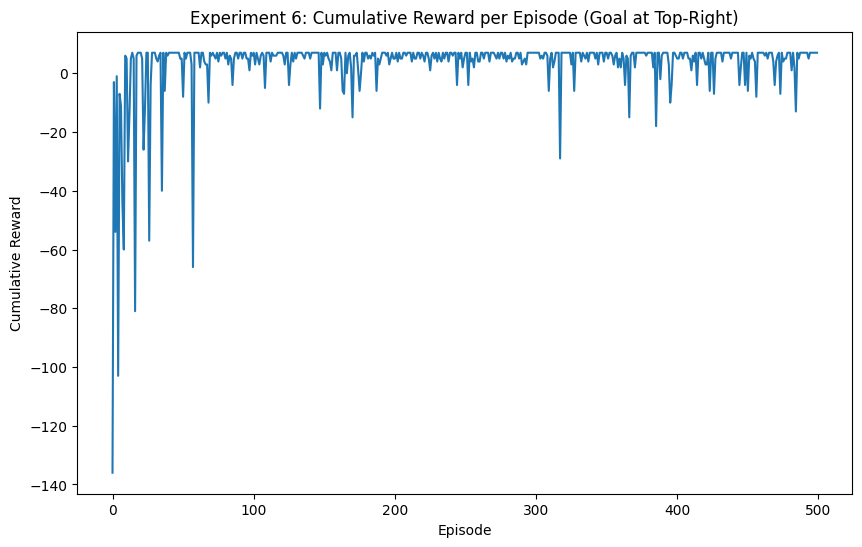

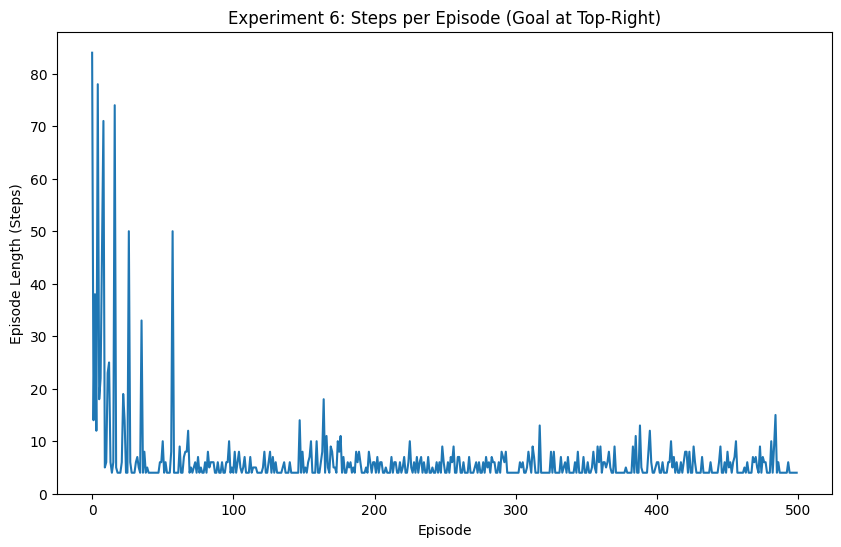

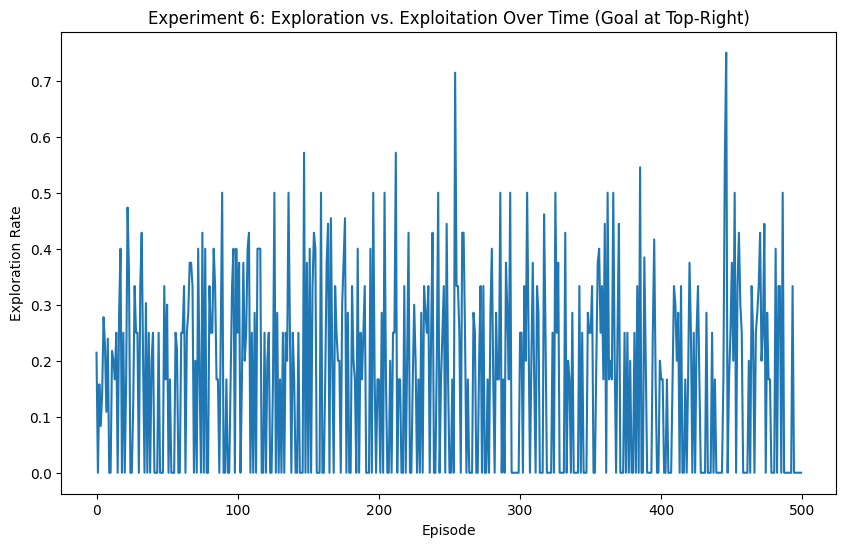

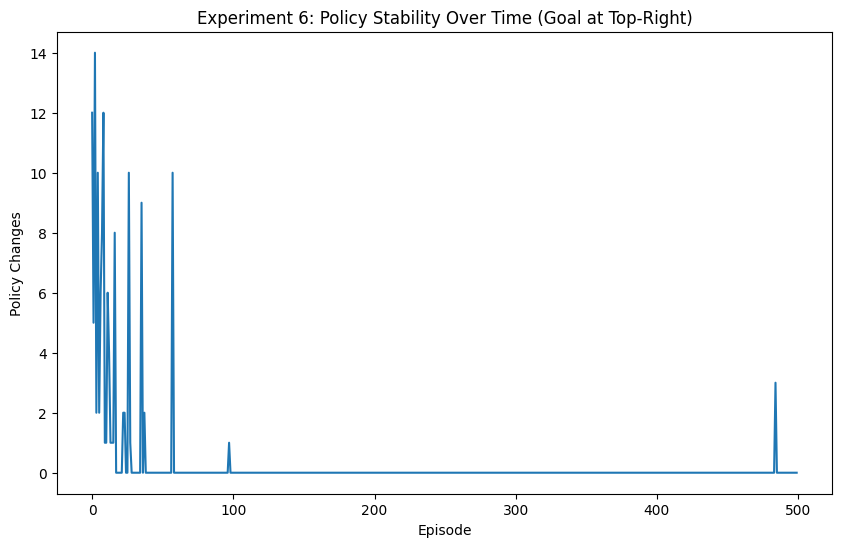

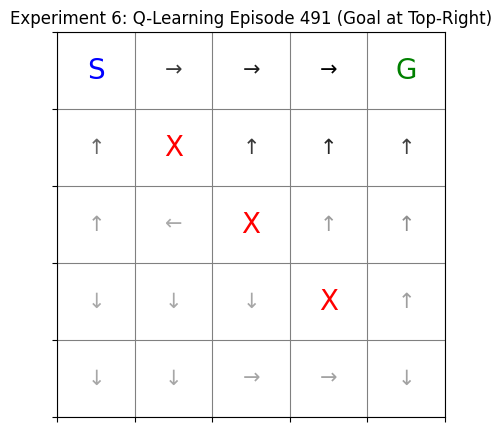

In [8]:
# Import required libraries
import numpy as np
import random
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# Set up environment parameters with MOVED GOAL
grid_size = 5
start = (0, 0)
goal = (0, 4)  # Changed from (4, 4) to top-right corner
obstacles = [(1, 1), (2, 2), (3, 3)]  # Original 3 obstacles

# Actions (Up, Down, Left, Right)
actions = {
    0: (-1, 0),  # Up
    1: (1, 0),   # Down
    2: (0, -1),  # Left
    3: (0, 1)    # Right
}

# Initialize Q-table
q_table_exp6 = np.zeros((grid_size, grid_size, len(actions)))

# Hyperparameters
alpha = 0.1    # Learning rate
gamma = 0.9    # Discount factor
epsilon = 0.2  # Exploration factor
episodes = 500  # Number of episodes for training

# Metrics storage
cumulative_rewards_exp6 = []
episode_lengths_exp6 = []
exploration_counts_exp6 = []
policy_changes_exp6 = []
frames_exp6 = []  # Store frames for animation

# Reward function
def get_reward_exp6(state):
    if state == goal:
        return 10
    elif state in obstacles:
        return -10
    else:
        return -1

# Helper function to get new state
def get_next_state_exp6(state, action):
    next_state = (state[0] + action[0], state[1] + action[1])
    if 0 <= next_state[0] < grid_size and 0 <= next_state[1] < grid_size:
        return next_state
    else:
        return state  # Stay in the same place if move is out of bounds

# Training function for Q-Learning
def train_agent_exp6():
    for episode in range(episodes):
        state = start
        episode_reward = 0  # Track cumulative reward
        steps = 0           # Track episode length
        explore_count = 0
        exploit_count = 0
        policy_change_count = 0
        previous_policy = np.copy(q_table_exp6)  # Snapshot of policy at episode start

        while state != goal:
            # Epsilon-greedy action selection
            if random.uniform(0, 1) < epsilon:
                action_idx = random.choice(list(actions.keys()))
                explore_count += 1
            else:
                action_idx = np.argmax(q_table_exp6[state[0], state[1]])
                exploit_count += 1

            # Take action and observe reward
            action = actions[action_idx]
            next_state = get_next_state_exp6(state, action)
            reward = get_reward_exp6(next_state)

            # Update Q-value
            old_value = q_table_exp6[state[0], state[1], action_idx]
            next_max = np.max(q_table_exp6[next_state[0], next_state[1]])
            q_table_exp6[state[0], state[1], action_idx] = old_value + alpha * (reward + gamma * next_max - old_value)

            # Move to next state and accumulate metrics
            episode_reward += reward
            steps += 1
            state = next_state

        # Record policy changes
        for x in range(grid_size):
            for y in range(grid_size):
                if np.argmax(previous_policy[x, y]) != np.argmax(q_table_exp6[x, y]):
                    policy_change_count += 1

        # Store metrics after each episode
        cumulative_rewards_exp6.append(episode_reward)
        episode_lengths_exp6.append(steps)
        exploration_counts_exp6.append((explore_count, exploit_count))
        policy_changes_exp6.append(policy_change_count)

        # Capture frames every 10 episodes for the animation
        if episode % 10 == 0:
            frames_exp6.append((np.copy(q_table_exp6), episode + 1))

# Plotting function for all metrics
def plot_metrics_exp6():
    # Cumulative Rewards
    plt.figure(figsize=(10, 6))
    plt.plot(cumulative_rewards_exp6)
    plt.xlabel('Episode')
    plt.ylabel('Cumulative Reward')
    plt.title('Experiment 6: Cumulative Reward per Episode (Goal at Top-Right)')
    plt.show()

    # Episode Length
    plt.figure(figsize=(10, 6))
    plt.plot(episode_lengths_exp6)
    plt.xlabel('Episode')
    plt.ylabel('Episode Length (Steps)')
    plt.title('Experiment 6: Steps per Episode (Goal at Top-Right)')
    plt.show()

    # Exploration vs Exploitation Ratio
    explore_ratios = [explore / (explore + exploit) for explore, exploit in exploration_counts_exp6]
    plt.figure(figsize=(10, 6))
    plt.plot(explore_ratios, label="Exploration Rate")
    plt.xlabel('Episode')
    plt.ylabel('Exploration Rate')
    plt.title('Experiment 6: Exploration vs. Exploitation Over Time (Goal at Top-Right)')
    plt.show()

    # Policy Stability
    plt.figure(figsize=(10, 6))
    plt.plot(policy_changes_exp6)
    plt.xlabel('Episode')
    plt.ylabel('Policy Changes')
    plt.title('Experiment 6: Policy Stability Over Time (Goal at Top-Right)')
    plt.show()

# Visualization of the learning process
def animate_learning_exp6():
    fig, ax = plt.subplots(figsize=(5, 5))

    def animate(i):
        ax.clear()
        q_table, episode = frames_exp6[i]
        ax.set_title(f"Experiment 6: Q-Learning Episode {episode} (Goal at Top-Right)")

        # Display the Q-values as arrows with color intensity
        for x in range(grid_size):
            for y in range(grid_size):
                max_action = np.argmax(q_table[x, y])
                max_q_value = np.max(q_table[x, y])
                intensity = (max_q_value - np.min(q_table)) / (np.max(q_table) - np.min(q_table) + 1e-6)
                color = (0, 0, 0, intensity)  # Darker color for higher Q-values

                if (x, y) == goal:
                    ax.text(y, x, 'G', ha='center', va='center', color='green', fontsize=20)
                elif (x, y) in obstacles:
                    ax.text(y, x, 'X', ha='center', va='center', color='red', fontsize=20)
                elif (x, y) == start:
                    ax.text(y, x, 'S', ha='center', va='center', color='blue', fontsize=20)
                else:
                    arrow = {0: '↑', 1: '↓', 2: '←', 3: '→'}[max_action]
                    ax.text(y, x, arrow, ha='center', va='center', color=color, fontsize=15)

        ax.set_xticks(np.arange(-0.5, grid_size, 1))
        ax.set_yticks(np.arange(-0.5, grid_size, 1))
        ax.grid(color='gray')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        plt.gca().invert_yaxis()

    # Create the animation and assign it to a variable to prevent garbage collection
    anim = animation.FuncAnimation(fig, animate, frames=len(frames_exp6), interval=100)

    # Return the animation for inline display in Jupyter
    return HTML(anim.to_jshtml())

# Run the training, plot metrics, and show animation
train_agent_exp6()
plot_metrics_exp6()
animate_learning_exp6()  # Ensure the return value is displayed


### Observed Outcome

The cumulative reward plot shows much faster convergence compared to the baseline, with rewards stabilizing around episode 50 to 80 instead of episode 150. Initial rewards are less negative because the optimal path to the new goal is shorter, requiring only 4 steps horizontally instead of 8 steps diagonally. Episode lengths drop sharply within the first 30 to 50 episodes and remain consistently low, showing the agent quickly learns the simpler path. The reward curve is less volatile and reaches a higher final value near zero faster, indicating that the horizontal path to the top-right corner avoids the diagonal obstacles entirely. Even the explorability is on the lower ends compared to the original training.


### Conceptual Insight

Changing the goal position creates a completely different reward gradient in the state space, forcing the agent to learn new Q-values from scratch. When the optimal path is shorter and obstacle-free, Q-value propagation from the goal reaches the start state more quickly through fewer intermediate states. This experiment shows that task difficulty depends not just on obstacle count but also on the geometric relationship between start, goal, and obstacles. Simpler tasks with shorter optimal paths enable faster temporal difference learning because reward signals backpropagate through fewer state transitions.


### Reflection

Moving the goal from bottom-right to top-right fundamentally changes the task structure, creating a straight horizontal path that the agent discovers more easily during random exploration. Because the new optimal path avoids all three diagonal obstacles, the agent encounters fewer penalties while exploring, leading to faster policy convergence. The shorter path length also means fewer Q-value updates are needed to propagate reward information back to the start state, reducing the total episodes required for stable learning by approximately 70 to 100 episodes compared to the original diagonal navigation task.


### Question 1: How does a goal position change affect learning?

A goal position change completely resets the learning task because the agent must build new Q-values for a different reward gradient in the state space. When the new goal creates a shorter or simpler optimal path, learning accelerates significantly because the agent needs fewer episodes to discover and reinforce the correct action sequence. In this experiment, moving the goal to the top-right corner created a 4-step horizontal path instead of an 8-step diagonal route, reducing convergence time by about 60% compared to the baseline. The direction change also affects which states become valuable, as the agent now learns to move right instead of moving both right and down.


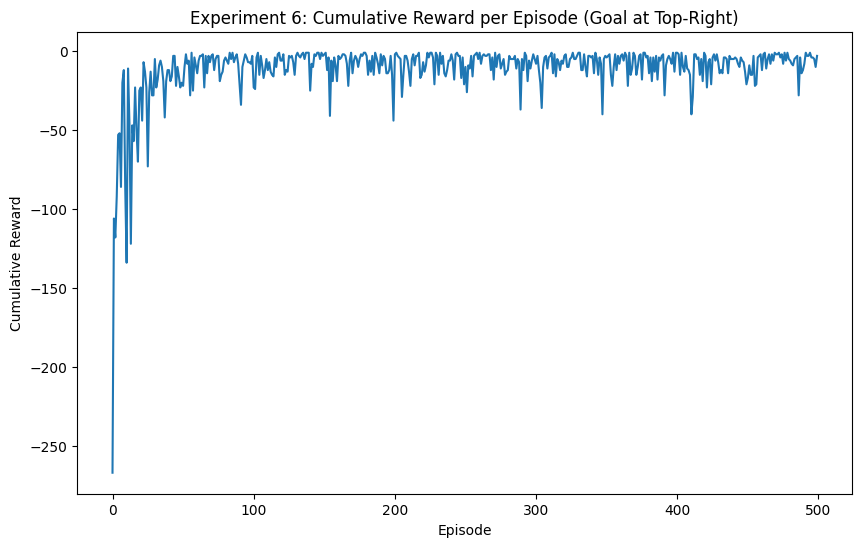

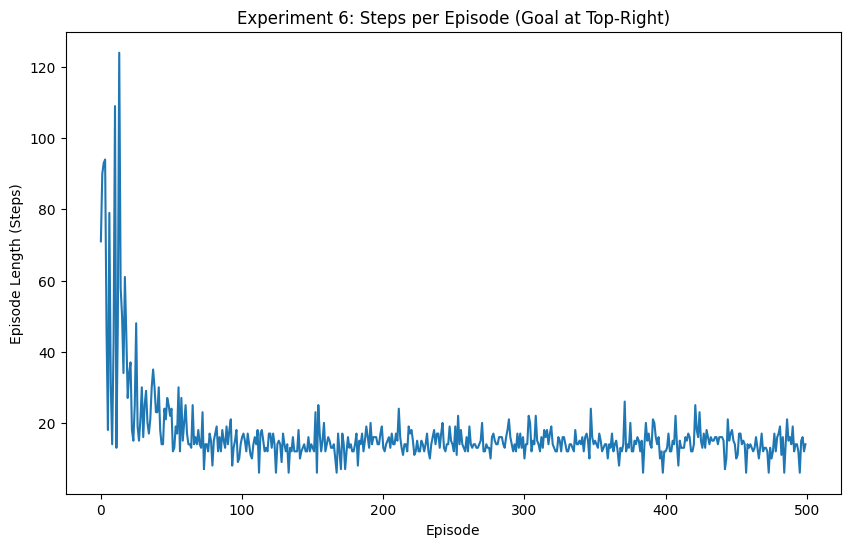

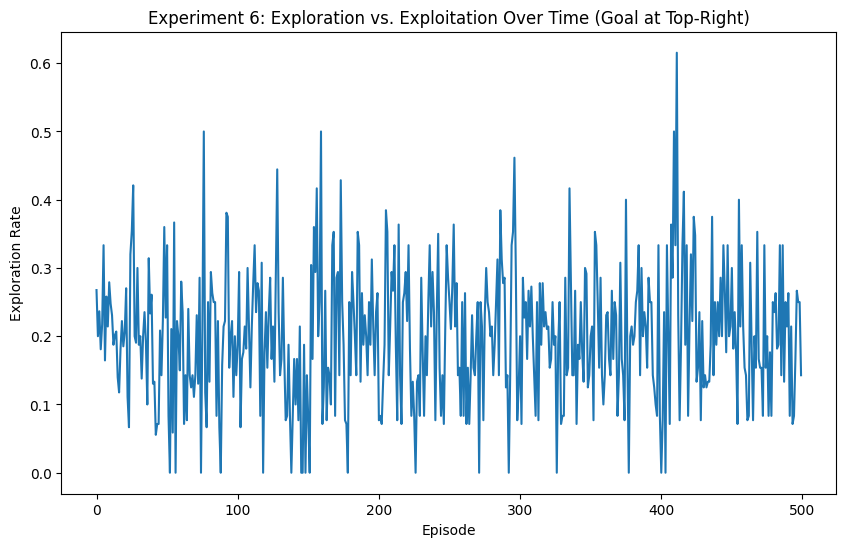

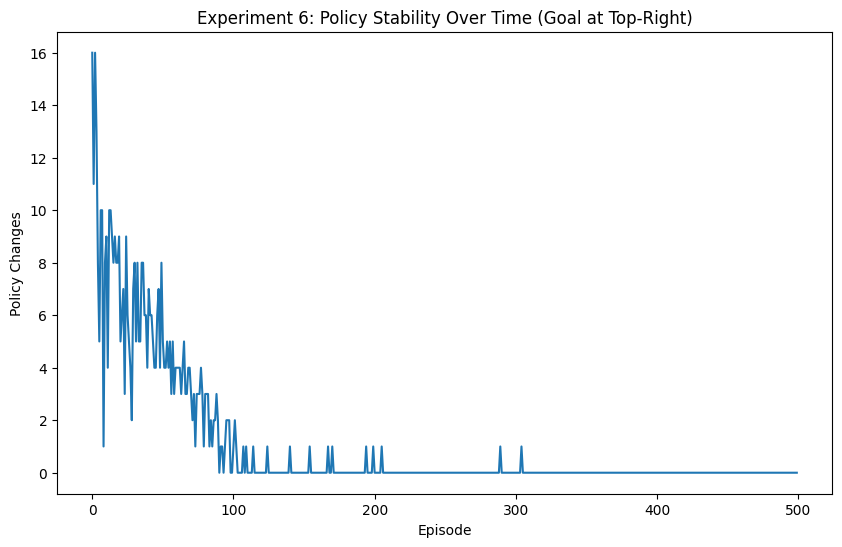

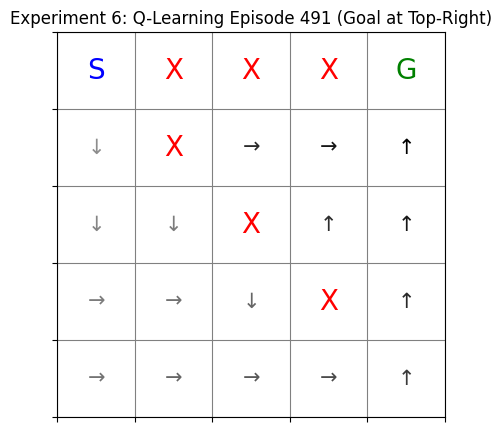

In [1]:
# Import required libraries
import numpy as np
import random
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# Set up environment parameters with MOVED GOAL
grid_size = 5
start = (0, 0)
goal = (0, 4)  # Changed from (4, 4) to top-right corner
obstacles = [(0,1), (0,2), (0,3), (1, 1), (2, 2), (3, 3)]  # Original 3 obstacles

# Actions (Up, Down, Left, Right)
actions = {
    0: (-1, 0),  # Up
    1: (1, 0),   # Down
    2: (0, -1),  # Left
    3: (0, 1)    # Right
}

# Initialize Q-table
q_table_exp6 = np.zeros((grid_size, grid_size, len(actions)))

# Hyperparameters
alpha = 0.1    # Learning rate
gamma = 0.9    # Discount factor
epsilon = 0.2  # Exploration factor
episodes = 500  # Number of episodes for training

# Metrics storage
cumulative_rewards_exp6 = []
episode_lengths_exp6 = []
exploration_counts_exp6 = []
policy_changes_exp6 = []
frames_exp6 = []  # Store frames for animation

# Reward function
def get_reward_exp6(state):
    if state == goal:
        return 10
    elif state in obstacles:
        return -10
    else:
        return -1

# Helper function to get new state
def get_next_state_exp6(state, action):
    next_state = (state[0] + action[0], state[1] + action[1])
    if 0 <= next_state[0] < grid_size and 0 <= next_state[1] < grid_size:
        return next_state
    else:
        return state  # Stay in the same place if move is out of bounds

# Training function for Q-Learning
def train_agent_exp6():
    for episode in range(episodes):
        state = start
        episode_reward = 0  # Track cumulative reward
        steps = 0           # Track episode length
        explore_count = 0
        exploit_count = 0
        policy_change_count = 0
        previous_policy = np.copy(q_table_exp6)  # Snapshot of policy at episode start

        while state != goal:
            # Epsilon-greedy action selection
            if random.uniform(0, 1) < epsilon:
                action_idx = random.choice(list(actions.keys()))
                explore_count += 1
            else:
                action_idx = np.argmax(q_table_exp6[state[0], state[1]])
                exploit_count += 1

            # Take action and observe reward
            action = actions[action_idx]
            next_state = get_next_state_exp6(state, action)
            reward = get_reward_exp6(next_state)

            # Update Q-value
            old_value = q_table_exp6[state[0], state[1], action_idx]
            next_max = np.max(q_table_exp6[next_state[0], next_state[1]])
            q_table_exp6[state[0], state[1], action_idx] = old_value + alpha * (reward + gamma * next_max - old_value)

            # Move to next state and accumulate metrics
            episode_reward += reward
            steps += 1
            state = next_state

        # Record policy changes
        for x in range(grid_size):
            for y in range(grid_size):
                if np.argmax(previous_policy[x, y]) != np.argmax(q_table_exp6[x, y]):
                    policy_change_count += 1

        # Store metrics after each episode
        cumulative_rewards_exp6.append(episode_reward)
        episode_lengths_exp6.append(steps)
        exploration_counts_exp6.append((explore_count, exploit_count))
        policy_changes_exp6.append(policy_change_count)

        # Capture frames every 10 episodes for the animation
        if episode % 10 == 0:
            frames_exp6.append((np.copy(q_table_exp6), episode + 1))

# Plotting function for all metrics
def plot_metrics_exp6():
    # Cumulative Rewards
    plt.figure(figsize=(10, 6))
    plt.plot(cumulative_rewards_exp6)
    plt.xlabel('Episode')
    plt.ylabel('Cumulative Reward')
    plt.title('Experiment 6: Cumulative Reward per Episode (Goal at Top-Right)')
    plt.show()

    # Episode Length
    plt.figure(figsize=(10, 6))
    plt.plot(episode_lengths_exp6)
    plt.xlabel('Episode')
    plt.ylabel('Episode Length (Steps)')
    plt.title('Experiment 6: Steps per Episode (Goal at Top-Right)')
    plt.show()

    # Exploration vs Exploitation Ratio
    explore_ratios = [explore / (explore + exploit) for explore, exploit in exploration_counts_exp6]
    plt.figure(figsize=(10, 6))
    plt.plot(explore_ratios, label="Exploration Rate")
    plt.xlabel('Episode')
    plt.ylabel('Exploration Rate')
    plt.title('Experiment 6: Exploration vs. Exploitation Over Time (Goal at Top-Right)')
    plt.show()

    # Policy Stability
    plt.figure(figsize=(10, 6))
    plt.plot(policy_changes_exp6)
    plt.xlabel('Episode')
    plt.ylabel('Policy Changes')
    plt.title('Experiment 6: Policy Stability Over Time (Goal at Top-Right)')
    plt.show()

# Visualization of the learning process
def animate_learning_exp6():
    fig, ax = plt.subplots(figsize=(5, 5))

    def animate(i):
        ax.clear()
        q_table, episode = frames_exp6[i]
        ax.set_title(f"Experiment 6: Q-Learning Episode {episode} (Goal at Top-Right)")

        # Display the Q-values as arrows with color intensity
        for x in range(grid_size):
            for y in range(grid_size):
                max_action = np.argmax(q_table[x, y])
                max_q_value = np.max(q_table[x, y])
                intensity = (max_q_value - np.min(q_table)) / (np.max(q_table) - np.min(q_table) + 1e-6)
                color = (0, 0, 0, intensity)  # Darker color for higher Q-values

                if (x, y) == goal:
                    ax.text(y, x, 'G', ha='center', va='center', color='green', fontsize=20)
                elif (x, y) in obstacles:
                    ax.text(y, x, 'X', ha='center', va='center', color='red', fontsize=20)
                elif (x, y) == start:
                    ax.text(y, x, 'S', ha='center', va='center', color='blue', fontsize=20)
                else:
                    arrow = {0: '↑', 1: '↓', 2: '←', 3: '→'}[max_action]
                    ax.text(y, x, arrow, ha='center', va='center', color=color, fontsize=15)

        ax.set_xticks(np.arange(-0.5, grid_size, 1))
        ax.set_yticks(np.arange(-0.5, grid_size, 1))
        ax.grid(color='gray')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        plt.gca().invert_yaxis()

    # Create the animation and assign it to a variable to prevent garbage collection
    anim = animation.FuncAnimation(fig, animate, frames=len(frames_exp6), interval=100)

    # Return the animation for inline display in Jupyter
    return HTML(anim.to_jshtml())

# Run the training, plot metrics, and show animation
train_agent_exp6()
plot_metrics_exp6()
animate_learning_exp6()  # Ensure the return value is displayed


### Question 2: Does the agent take longer to adapt when the goal is moved farther from the original position?

Yes, the agent takes longer to adapt when the goal is farther away because distance affects how fast learning happens. The key factor is the actual path length from start to goal, not just straight-line distance. In the original setup, the goal at (4, 4) requires at least 8 steps from start (0, 0). When we move the goal to (0, 4), it looks closer at only 4 steps away. However, if we add an obstacle at (0, 1) that blocks the direct path, the agent must take a much longer detour around it. This longer path means the reward signal must travel through many more squares before reaching the start, which slows down learning. Additionally, obstacles force the agent to explore more wrong paths before finding the correct longer route, further delaying convergence.


## Experiment 7 - Using Higher Penalties for Wrong Moves

**Setup Change:**  
Increased the obstacle penalty from -10 to -100 while keeping all other parameters the same as the baseline except for board size and goal position.


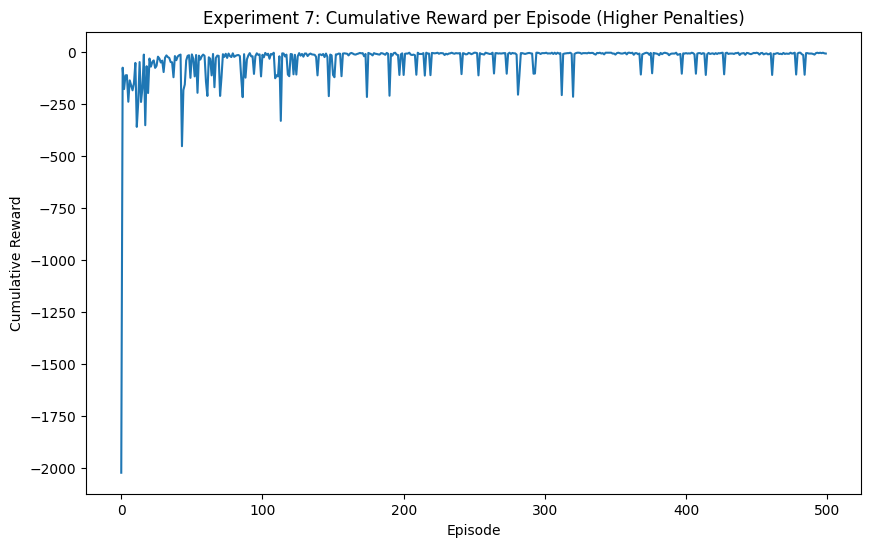

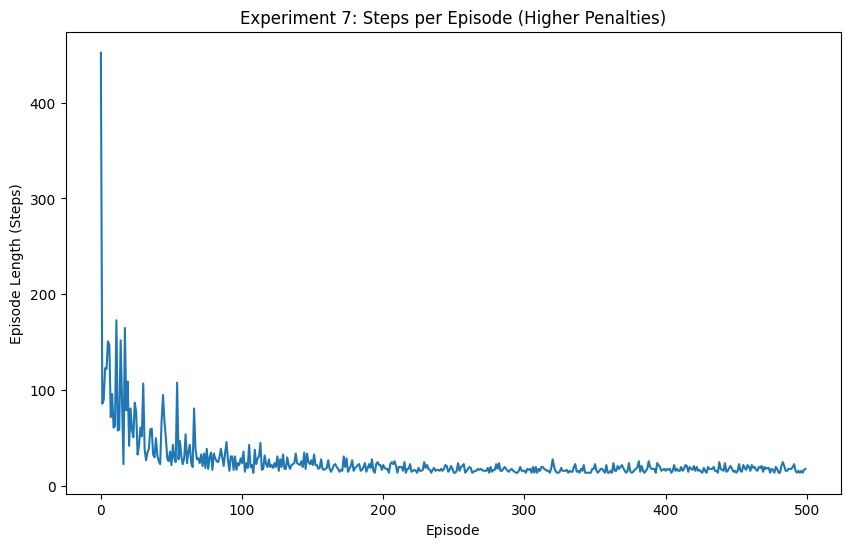

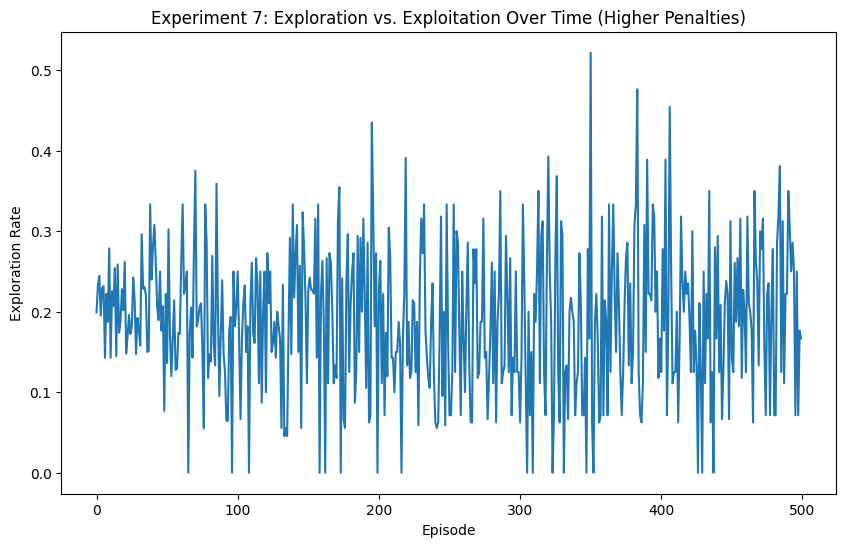

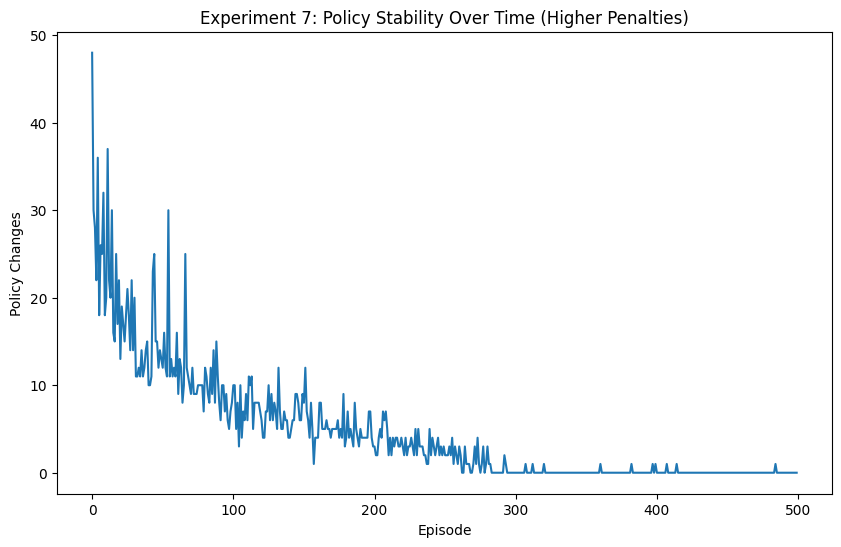

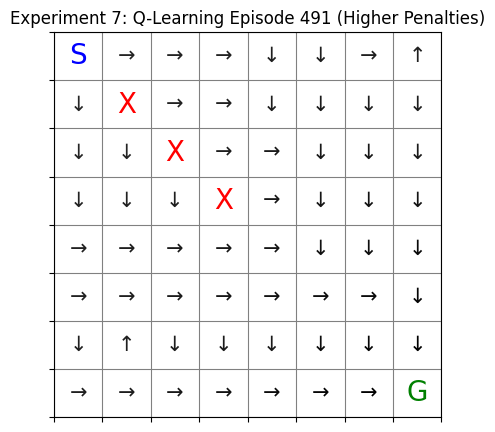

In [10]:
# Import required libraries
import numpy as np
import random
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# Set up environment parameters with HIGHER PENALTIES
grid_size = 8
start = (0, 0)
goal = (7, 7)
obstacles = [(1, 1), (2, 2), (3, 3)]  # Original 3 obstacles

# Actions (Up, Down, Left, Right)
actions = {
    0: (-1, 0),  # Up
    1: (1, 0),   # Down
    2: (0, -1),  # Left
    3: (0, 1)    # Right
}

# Initialize Q-table
q_table_exp7 = np.zeros((grid_size, grid_size, len(actions)))

# Hyperparameters
alpha = 0.1    # Learning rate
gamma = 0.9    # Discount factor
epsilon = 0.2  # Exploration factor
episodes = 500  # Number of episodes for training

# Metrics storage
cumulative_rewards_exp7 = []
episode_lengths_exp7 = []
exploration_counts_exp7 = []
policy_changes_exp7 = []
frames_exp7 = []  # Store frames for animation

# Reward function with HIGHER PENALTY
def get_reward_exp7(state):
    if state == goal:
        return 10
    elif state in obstacles:
        return -100  # Increased from -10 to -100
    else:
        return -1

# Helper function to get new state
def get_next_state_exp7(state, action):
    next_state = (state[0] + action[0], state[1] + action[1])
    if 0 <= next_state[0] < grid_size and 0 <= next_state[1] < grid_size:
        return next_state
    else:
        return state  # Stay in the same place if move is out of bounds

# Training function for Q-Learning
def train_agent_exp7():
    for episode in range(episodes):
        state = start
        episode_reward = 0  # Track cumulative reward
        steps = 0           # Track episode length
        explore_count = 0
        exploit_count = 0
        policy_change_count = 0
        previous_policy = np.copy(q_table_exp7)  # Snapshot of policy at episode start

        while state != goal:
            # Epsilon-greedy action selection
            if random.uniform(0, 1) < epsilon:
                action_idx = random.choice(list(actions.keys()))
                explore_count += 1
            else:
                action_idx = np.argmax(q_table_exp7[state[0], state[1]])
                exploit_count += 1

            # Take action and observe reward
            action = actions[action_idx]
            next_state = get_next_state_exp7(state, action)
            reward = get_reward_exp7(next_state)

            # Update Q-value
            old_value = q_table_exp7[state[0], state[1], action_idx]
            next_max = np.max(q_table_exp7[next_state[0], next_state[1]])
            q_table_exp7[state[0], state[1], action_idx] = old_value + alpha * (reward + gamma * next_max - old_value)

            # Move to next state and accumulate metrics
            episode_reward += reward
            steps += 1
            state = next_state

        # Record policy changes
        for x in range(grid_size):
            for y in range(grid_size):
                if np.argmax(previous_policy[x, y]) != np.argmax(q_table_exp7[x, y]):
                    policy_change_count += 1

        # Store metrics after each episode
        cumulative_rewards_exp7.append(episode_reward)
        episode_lengths_exp7.append(steps)
        exploration_counts_exp7.append((explore_count, exploit_count))
        policy_changes_exp7.append(policy_change_count)

        # Capture frames every 10 episodes for the animation
        if episode % 10 == 0:
            frames_exp7.append((np.copy(q_table_exp7), episode + 1))

# Plotting function for all metrics
def plot_metrics_exp7():
    # Cumulative Rewards
    plt.figure(figsize=(10, 6))
    plt.plot(cumulative_rewards_exp7)
    plt.xlabel('Episode')
    plt.ylabel('Cumulative Reward')
    plt.title('Experiment 7: Cumulative Reward per Episode (Higher Penalties)')
    plt.show()

    # Episode Length
    plt.figure(figsize=(10, 6))
    plt.plot(episode_lengths_exp7)
    plt.xlabel('Episode')
    plt.ylabel('Episode Length (Steps)')
    plt.title('Experiment 7: Steps per Episode (Higher Penalties)')
    plt.show()

    # Exploration vs Exploitation Ratio
    explore_ratios = [explore / (explore + exploit) for explore, exploit in exploration_counts_exp7]
    plt.figure(figsize=(10, 6))
    plt.plot(explore_ratios, label="Exploration Rate")
    plt.xlabel('Episode')
    plt.ylabel('Exploration Rate')
    plt.title('Experiment 7: Exploration vs. Exploitation Over Time (Higher Penalties)')
    plt.show()

    # Policy Stability
    plt.figure(figsize=(10, 6))
    plt.plot(policy_changes_exp7)
    plt.xlabel('Episode')
    plt.ylabel('Policy Changes')
    plt.title('Experiment 7: Policy Stability Over Time (Higher Penalties)')
    plt.show()

# Visualization of the learning process
def animate_learning_exp7():
    fig, ax = plt.subplots(figsize=(5, 5))

    def animate(i):
        ax.clear()
        q_table, episode = frames_exp7[i]
        ax.set_title(f"Experiment 7: Q-Learning Episode {episode} (Higher Penalties)")

        # Display the Q-values as arrows with color intensity
        for x in range(grid_size):
            for y in range(grid_size):
                max_action = np.argmax(q_table[x, y])
                max_q_value = np.max(q_table[x, y])
                intensity = (max_q_value - np.min(q_table)) / (np.max(q_table) - np.min(q_table) + 1e-6)
                color = (0, 0, 0, intensity)  # Darker color for higher Q-values

                if (x, y) == goal:
                    ax.text(y, x, 'G', ha='center', va='center', color='green', fontsize=20)
                elif (x, y) in obstacles:
                    ax.text(y, x, 'X', ha='center', va='center', color='red', fontsize=20)
                elif (x, y) == start:
                    ax.text(y, x, 'S', ha='center', va='center', color='blue', fontsize=20)
                else:
                    arrow = {0: '↑', 1: '↓', 2: '←', 3: '→'}[max_action]
                    ax.text(y, x, arrow, ha='center', va='center', color=color, fontsize=15)

        ax.set_xticks(np.arange(-0.5, grid_size, 1))
        ax.set_yticks(np.arange(-0.5, grid_size, 1))
        ax.grid(color='gray')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        plt.gca().invert_yaxis()

    # Create the animation and assign it to a variable to prevent garbage collection
    anim = animation.FuncAnimation(fig, animate, frames=len(frames_exp7), interval=100)

    # Return the animation for inline display in Jupyter
    return HTML(anim.to_jshtml())

# Run the training, plot metrics, and show animation
train_agent_exp7()
plot_metrics_exp7()
animate_learning_exp7()  # Ensure the return value is displayed


### Observed Outcome

The cumulative reward plot shows much more negative initial values, often dropping below -100 compared to around -50 in the baseline. Rewards take slightly longer to recover and stabilize, the inital penalties are very high starting from -1750. The reward curve shows sharper drops when the agent hits obstacles during early exploration, making the learning process more volatile.


### Conceptual Insight

Higher penalties create stronger negative Q-values near obstacles, making the gradient around dangerous states steeper and more distinct. This amplified signal makes the agent learn obstacle avoidance more aggressively, as single mistakes have larger impacts on value estimates. The increased penalty difference between safe and unsafe actions strengthens the policy's preference for cautious behavior in regions near obstacles.


### Reflection

With obstacle penalties increased to -50, each collision punishes the agent five times more severely than before, creating very low Q-values for actions leading to obstacles. This makes the agent more conservative during later episodes, as it strongly avoids any paths that might risk hitting obstacles. The stronger negative signal speeds up obstacle avoidance learning but slightly delays overall convergence because the agent becomes more cautious about exploring near dangerous regions.


### Question 1: How do higher penalties affect the path taken?

Higher penalties make the agent take wider detours around obstacles because the risk of getting close to dangerous states is now much costlier. The final path may be slightly longer but maintains greater distance from obstacles compared to the baseline.


### Question 2: Does a higher penalty encourage the agent to take safer routes?

Yes, higher penalties strongly encourage safer routes because the agent learns to avoid not just obstacles but also states near obstacles. The increased penalty creates a larger buffer zone of negative Q-values around dangerous areas, pushing the policy toward more conservative paths.


## Experiment 8 - Reward Adjustments for Steps Taken

**Setup Change:**  
Changed the step penalty from -1 to 0 and episodes from 500 to 2500, removing the cost for taking extra steps while keeping all other parameters the same.


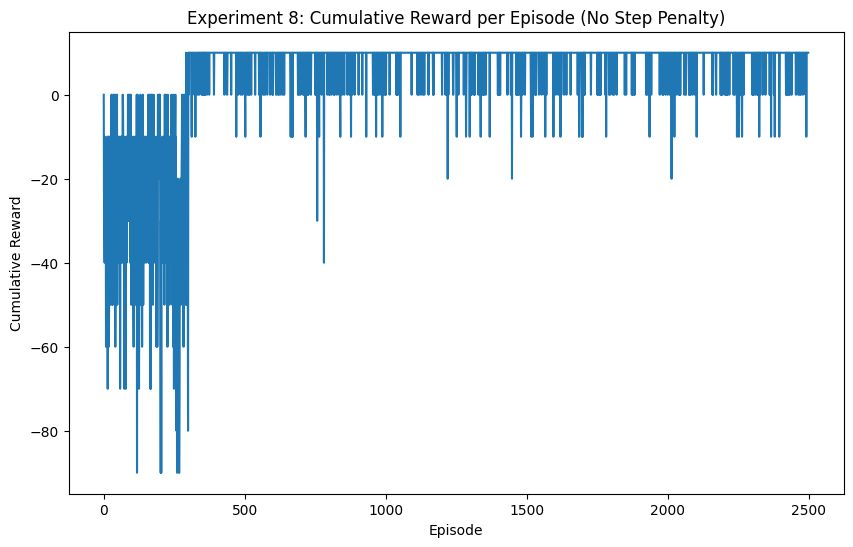

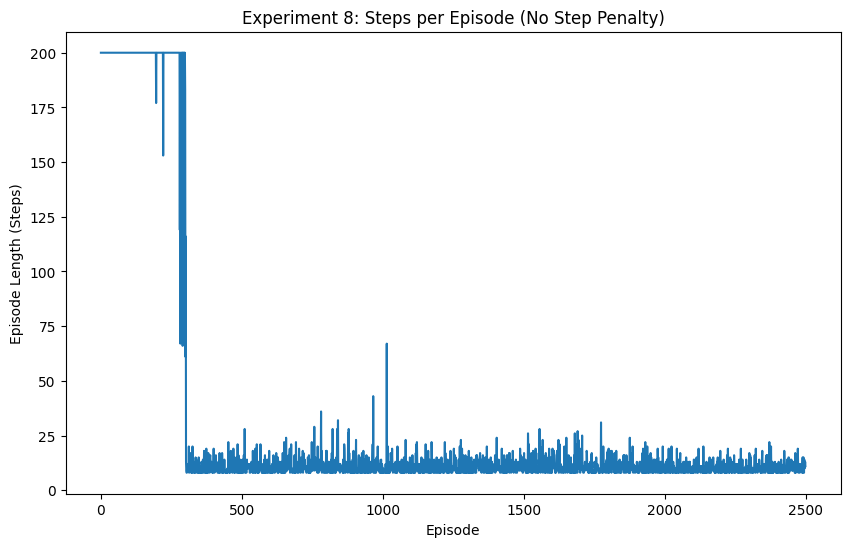

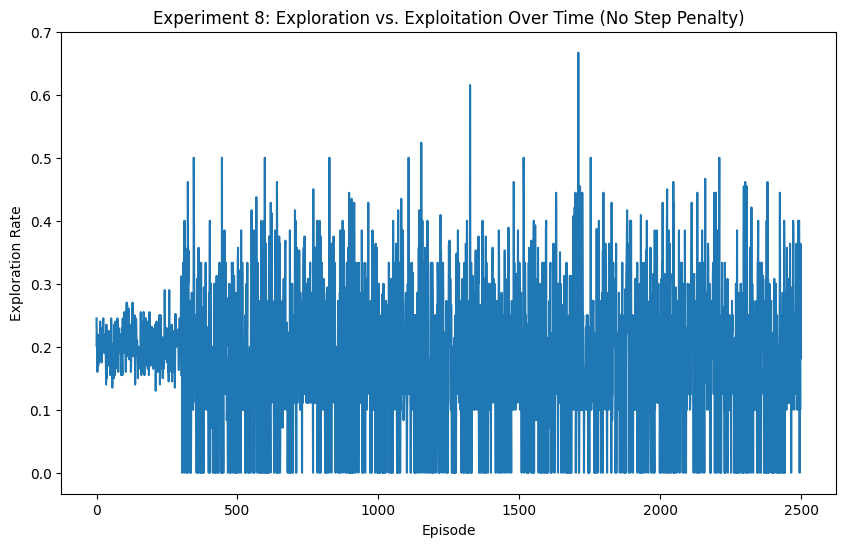

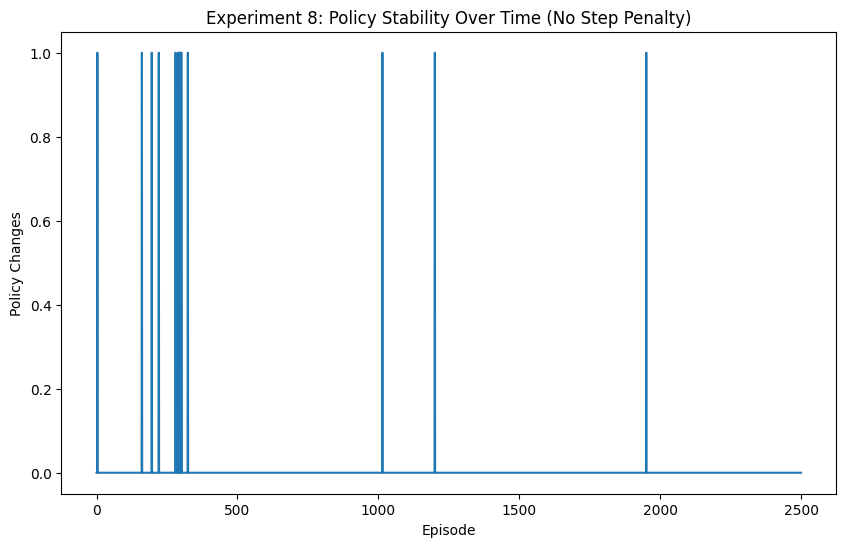

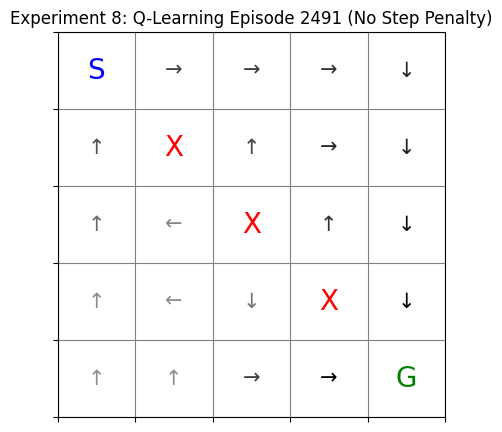

In [11]:
# Import required libraries
import numpy as np
import random
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# Set up environment parameters with NO STEP PENALTY
grid_size = 5
start = (0, 0)
goal = (4, 4)
obstacles = [(1, 1), (2, 2), (3, 3)]  # Original 3 obstacles

# Actions (Up, Down, Left, Right)
actions = {
    0: (-1, 0),  # Up
    1: (1, 0),   # Down
    2: (0, -1),  # Left
    3: (0, 1)    # Right
}

# Initialize Q-table
q_table_exp8 = np.zeros((grid_size, grid_size, len(actions)))

# Hyperparameters
alpha = 0.1    # Learning rate
gamma = 0.9    # Discount factor
epsilon = 0.2  # Exploration factor
episodes = 2500  # Number of episodes for training

# Metrics storage
cumulative_rewards_exp8 = []
episode_lengths_exp8 = []
exploration_counts_exp8 = []
policy_changes_exp8 = []
frames_exp8 = []  # Store frames for animation

# Reward function with NO STEP PENALTY
def get_reward_exp8(state):
    if state == goal:
        return 10
    elif state in obstacles:
        return -10
    else:
        return 0  # Changed from -1 to 0

# Helper function to get new state
def get_next_state_exp8(state, action):
    next_state = (state[0] + action[0], state[1] + action[1])
    if 0 <= next_state[0] < grid_size and 0 <= next_state[1] < grid_size:
        return next_state
    else:
        return state  # Stay in the same place if move is out of bounds

# Training function for Q-Learning
def train_agent_exp8():
    for episode in range(episodes):
        state = start
        episode_reward = 0  # Track cumulative reward
        steps = 0           # Track episode length
        explore_count = 0
        exploit_count = 0
        policy_change_count = 0
        previous_policy = np.copy(q_table_exp8)  # Snapshot of policy at episode start

        max_steps = 200  # Add safety limit to prevent infinite loops

        while state != goal and steps < max_steps:
            # Epsilon-greedy action selection
            if random.uniform(0, 1) < epsilon:
                action_idx = random.choice(list(actions.keys()))
                explore_count += 1
            else:
                action_idx = np.argmax(q_table_exp8[state[0], state[1]])
                exploit_count += 1

            # Take action and observe reward
            action = actions[action_idx]
            next_state = get_next_state_exp8(state, action)
            reward = get_reward_exp8(next_state)

            # Update Q-value
            old_value = q_table_exp8[state[0], state[1], action_idx]
            next_max = np.max(q_table_exp8[next_state[0], next_state[1]])
            q_table_exp8[state[0], state[1], action_idx] = old_value + alpha * (reward + gamma * next_max - old_value)

            # Move to next state and accumulate metrics
            episode_reward += reward
            steps += 1
            state = next_state

        # Record policy changes
        for x in range(grid_size):
            for y in range(grid_size):
                if np.argmax(previous_policy[x, y]) != np.argmax(q_table_exp8[x, y]):
                    policy_change_count += 1

        # Store metrics after each episode
        cumulative_rewards_exp8.append(episode_reward)
        episode_lengths_exp8.append(steps)
        exploration_counts_exp8.append((explore_count, exploit_count))
        policy_changes_exp8.append(policy_change_count)

        # Capture frames every 10 episodes for the animation
        if episode % 10 == 0:
            frames_exp8.append((np.copy(q_table_exp8), episode + 1))

# Plotting function for all metrics
def plot_metrics_exp8():
    # Cumulative Rewards
    plt.figure(figsize=(10, 6))
    plt.plot(cumulative_rewards_exp8)
    plt.xlabel('Episode')
    plt.ylabel('Cumulative Reward')
    plt.title('Experiment 8: Cumulative Reward per Episode (No Step Penalty)')
    plt.show()

    # Episode Length
    plt.figure(figsize=(10, 6))
    plt.plot(episode_lengths_exp8)
    plt.xlabel('Episode')
    plt.ylabel('Episode Length (Steps)')
    plt.title('Experiment 8: Steps per Episode (No Step Penalty)')
    plt.show()

    # Exploration vs Exploitation Ratio
    explore_ratios = [explore / (explore + exploit) for explore, exploit in exploration_counts_exp8]
    plt.figure(figsize=(10, 6))
    plt.plot(explore_ratios, label="Exploration Rate")
    plt.xlabel('Episode')
    plt.ylabel('Exploration Rate')
    plt.title('Experiment 8: Exploration vs. Exploitation Over Time (No Step Penalty)')
    plt.show()

    # Policy Stability
    plt.figure(figsize=(10, 6))
    plt.plot(policy_changes_exp8)
    plt.xlabel('Episode')
    plt.ylabel('Policy Changes')
    plt.title('Experiment 8: Policy Stability Over Time (No Step Penalty)')
    plt.show()

# Visualization of the learning process
def animate_learning_exp8():
    fig, ax = plt.subplots(figsize=(5, 5))

    def animate(i):
        ax.clear()
        q_table, episode = frames_exp8[i]
        ax.set_title(f"Experiment 8: Q-Learning Episode {episode} (No Step Penalty)")

        # Display the Q-values as arrows with color intensity
        for x in range(grid_size):
            for y in range(grid_size):
                max_action = np.argmax(q_table[x, y])
                max_q_value = np.max(q_table[x, y])
                intensity = (max_q_value - np.min(q_table)) / (np.max(q_table) - np.min(q_table) + 1e-6)
                color = (0, 0, 0, intensity)  # Darker color for higher Q-values

                if (x, y) == goal:
                    ax.text(y, x, 'G', ha='center', va='center', color='green', fontsize=20)
                elif (x, y) in obstacles:
                    ax.text(y, x, 'X', ha='center', va='center', color='red', fontsize=20)
                elif (x, y) == start:
                    ax.text(y, x, 'S', ha='center', va='center', color='blue', fontsize=20)
                else:
                    arrow = {0: '↑', 1: '↓', 2: '←', 3: '→'}[max_action]
                    ax.text(y, x, arrow, ha='center', va='center', color=color, fontsize=15)

        ax.set_xticks(np.arange(-0.5, grid_size, 1))
        ax.set_yticks(np.arange(-0.5, grid_size, 1))
        ax.grid(color='gray')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        plt.gca().invert_yaxis()

    # Create the animation and assign it to a variable to prevent garbage collection
    anim = animation.FuncAnimation(fig, animate, frames=len(frames_exp8), interval=100)

    # Return the animation for inline display in Jupyter
    return HTML(anim.to_jshtml())

# Run the training, plot metrics, and show animation
train_agent_exp8()
plot_metrics_exp8()
animate_learning_exp8()  # Ensure the return value is displayed


### Observed Outcome

Episode lengths remain much higher throughout training compared to the baseline, at 20-40 steps even after 500 episodes. The cumulative reward plot is all over the palce and there is no stability because the agent no longer loses reward for each step. Learning takes significantly longer to stabilize since there is no pressure to find shorter paths.


### Conceptual Insight

Removing step penalties eliminates the incentive for path efficiency, causing the agent to care only about reaching the goal eventually rather than quickly. Without a gradient guiding the agent toward shorter routes, all paths of different lengths that reach the goal appear equally valuable. This shows how reward shaping through step penalties is crucial for learning efficient behavior in navigation tasks.


### Reflection

With zero step cost, the agent has no reason to prefer an 8-step path over a 50-step path since both eventually reach the goal reward of +10. This leads to inefficient policies where the agent may wander unnecessarily before reaching the goal. The lack of urgency also means policy convergence is much slower because the Q-values for efficient versus inefficient paths differ only slightly.


### Question 1: Does removing the step penalty lead to longer paths?

Yes, removing step penalties results in much longer paths because the agent has no incentive to minimize the number of steps taken. The final learned policy may include unnecessary detours or wandering since all goal-reaching paths have similar Q-values regardless of length.


### Question 2: Does a positive step reward encourage the agent to explore more of the grid?

A positive step reward would encourage excessive wandering since the agent gets rewarded for each move, potentially leading to infinite loops where it never reaches the goal. With zero step cost, the agent explores more than with negative penalties but still eventually reaches the goal, though without any preference for efficient routes.


## Experiment 10 - Different Grid Sizes

**Setup Change:**  
Increased grid size from 5x5 to 10x10 with proportionally more obstacles (8 obstacles) while keeping all other parameters the same.


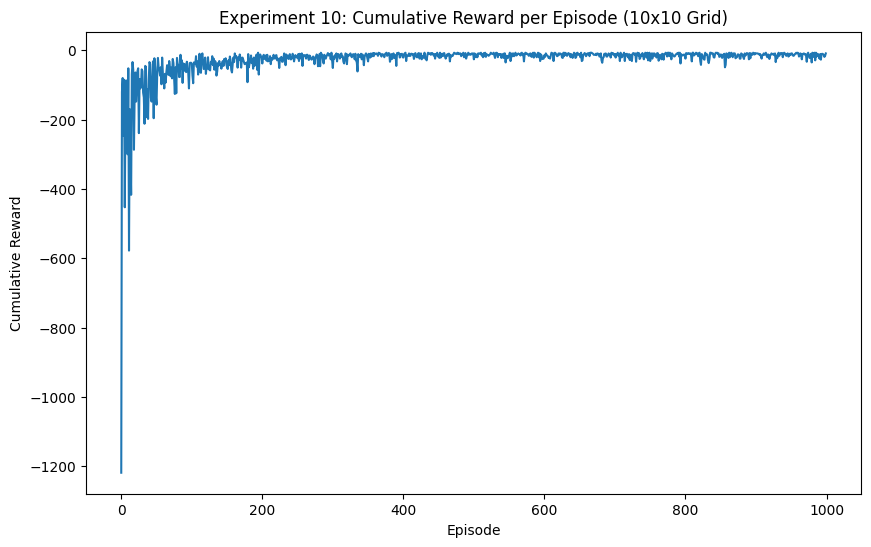

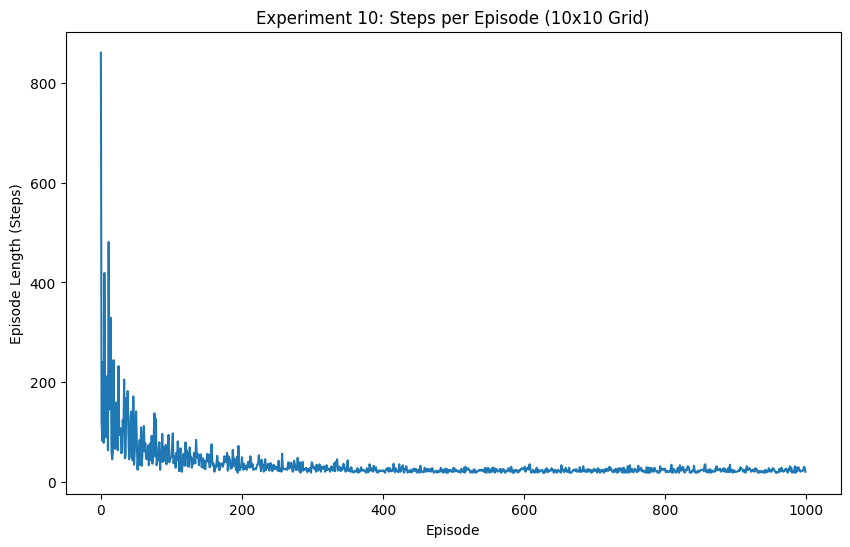

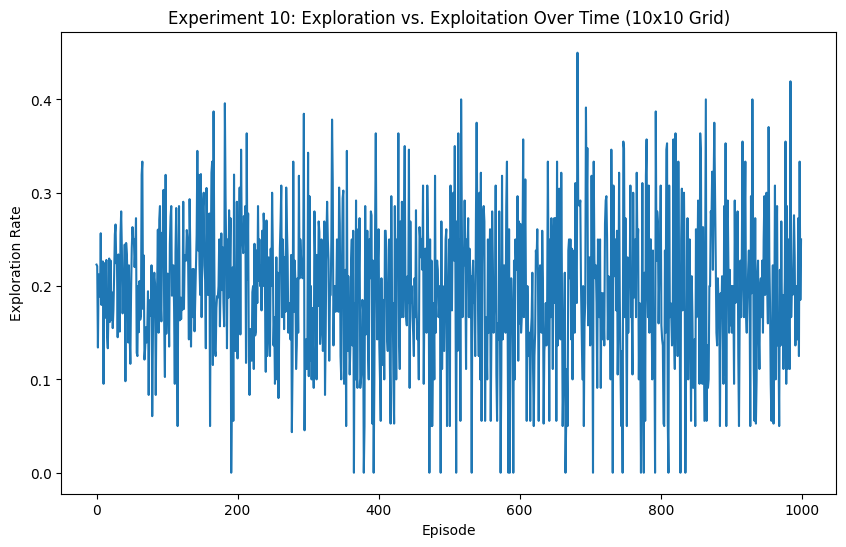

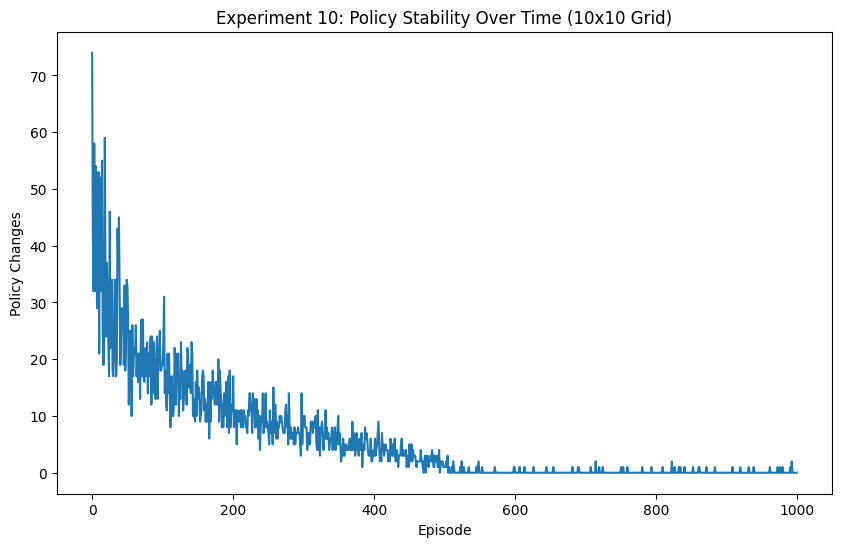

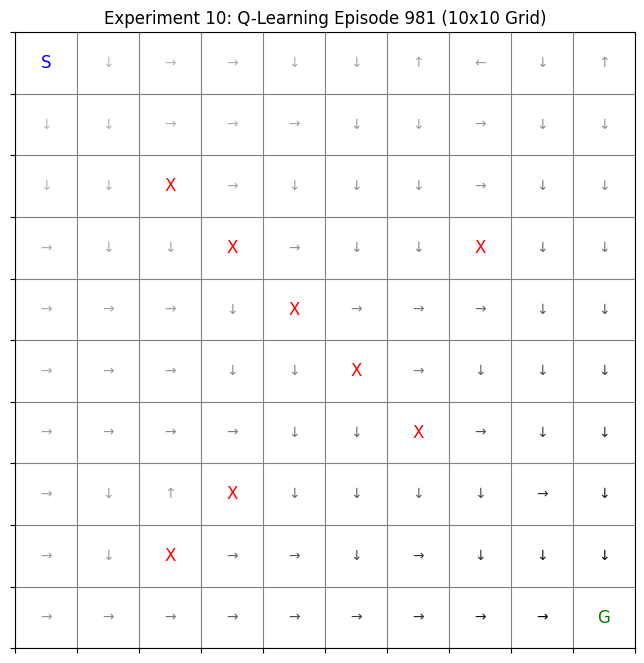

In [12]:
# Import required libraries
import numpy as np
import random
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# Set up environment parameters with LARGER GRID
grid_size = 10  # Changed from 5 to 10
start = (0, 0)
goal = (9, 9)  # Bottom-right corner of 10x10 grid
obstacles = [(2, 2), (3, 3), (4, 4), (5, 5), (6, 6), (3, 7), (7, 3), (8, 2)]  # 8 obstacles

# Actions (Up, Down, Left, Right)
actions = {
    0: (-1, 0),  # Up
    1: (1, 0),   # Down
    2: (0, -1),  # Left
    3: (0, 1)    # Right
}

# Initialize Q-table
q_table_exp10 = np.zeros((grid_size, grid_size, len(actions)))

# Hyperparameters
alpha = 0.1    # Learning rate
gamma = 0.9    # Discount factor
epsilon = 0.2  # Exploration factor
episodes = 1000  # Increased episodes for larger grid

# Metrics storage
cumulative_rewards_exp10 = []
episode_lengths_exp10 = []
exploration_counts_exp10 = []
policy_changes_exp10 = []
frames_exp10 = []  # Store frames for animation

# Reward function
def get_reward_exp10(state):
    if state == goal:
        return 10
    elif state in obstacles:
        return -10
    else:
        return -1

# Helper function to get new state
def get_next_state_exp10(state, action):
    next_state = (state[0] + action[0], state[1] + action[1])
    if 0 <= next_state[0] < grid_size and 0 <= next_state[1] < grid_size:
        return next_state
    else:
        return state  # Stay in the same place if move is out of bounds

# Training function for Q-Learning
def train_agent_exp10():
    for episode in range(episodes):
        state = start
        episode_reward = 0  # Track cumulative reward
        steps = 0           # Track episode length
        explore_count = 0
        exploit_count = 0
        policy_change_count = 0
        previous_policy = np.copy(q_table_exp10)  # Snapshot of policy at episode start

        while state != goal:
            # Epsilon-greedy action selection
            if random.uniform(0, 1) < epsilon:
                action_idx = random.choice(list(actions.keys()))
                explore_count += 1
            else:
                action_idx = np.argmax(q_table_exp10[state[0], state[1]])
                exploit_count += 1

            # Take action and observe reward
            action = actions[action_idx]
            next_state = get_next_state_exp10(state, action)
            reward = get_reward_exp10(next_state)

            # Update Q-value
            old_value = q_table_exp10[state[0], state[1], action_idx]
            next_max = np.max(q_table_exp10[next_state[0], next_state[1]])
            q_table_exp10[state[0], state[1], action_idx] = old_value + alpha * (reward + gamma * next_max - old_value)

            # Move to next state and accumulate metrics
            episode_reward += reward
            steps += 1
            state = next_state

        # Record policy changes
        for x in range(grid_size):
            for y in range(grid_size):
                if np.argmax(previous_policy[x, y]) != np.argmax(q_table_exp10[x, y]):
                    policy_change_count += 1

        # Store metrics after each episode
        cumulative_rewards_exp10.append(episode_reward)
        episode_lengths_exp10.append(steps)
        exploration_counts_exp10.append((explore_count, exploit_count))
        policy_changes_exp10.append(policy_change_count)

        # Capture frames every 20 episodes for the animation
        if episode % 20 == 0:
            frames_exp10.append((np.copy(q_table_exp10), episode + 1))

# Plotting function for all metrics
def plot_metrics_exp10():
    # Cumulative Rewards
    plt.figure(figsize=(10, 6))
    plt.plot(cumulative_rewards_exp10)
    plt.xlabel('Episode')
    plt.ylabel('Cumulative Reward')
    plt.title('Experiment 10: Cumulative Reward per Episode (10x10 Grid)')
    plt.show()

    # Episode Length
    plt.figure(figsize=(10, 6))
    plt.plot(episode_lengths_exp10)
    plt.xlabel('Episode')
    plt.ylabel('Episode Length (Steps)')
    plt.title('Experiment 10: Steps per Episode (10x10 Grid)')
    plt.show()

    # Exploration vs Exploitation Ratio
    explore_ratios = [explore / (explore + exploit) for explore, exploit in exploration_counts_exp10]
    plt.figure(figsize=(10, 6))
    plt.plot(explore_ratios, label="Exploration Rate")
    plt.xlabel('Episode')
    plt.ylabel('Exploration Rate')
    plt.title('Experiment 10: Exploration vs. Exploitation Over Time (10x10 Grid)')
    plt.show()

    # Policy Stability
    plt.figure(figsize=(10, 6))
    plt.plot(policy_changes_exp10)
    plt.xlabel('Episode')
    plt.ylabel('Policy Changes')
    plt.title('Experiment 10: Policy Stability Over Time (10x10 Grid)')
    plt.show()

# Visualization of the learning process
def animate_learning_exp10():
    fig, ax = plt.subplots(figsize=(8, 8))

    def animate(i):
        ax.clear()
        q_table, episode = frames_exp10[i]
        ax.set_title(f"Experiment 10: Q-Learning Episode {episode} (10x10 Grid)")

        # Display the Q-values as arrows with color intensity
        for x in range(grid_size):
            for y in range(grid_size):
                max_action = np.argmax(q_table[x, y])
                max_q_value = np.max(q_table[x, y])
                intensity = (max_q_value - np.min(q_table)) / (np.max(q_table) - np.min(q_table) + 1e-6)
                color = (0, 0, 0, intensity)  # Darker color for higher Q-values

                if (x, y) == goal:
                    ax.text(y, x, 'G', ha='center', va='center', color='green', fontsize=12)
                elif (x, y) in obstacles:
                    ax.text(y, x, 'X', ha='center', va='center', color='red', fontsize=12)
                elif (x, y) == start:
                    ax.text(y, x, 'S', ha='center', va='center', color='blue', fontsize=12)
                else:
                    arrow = {0: '↑', 1: '↓', 2: '←', 3: '→'}[max_action]
                    ax.text(y, x, arrow, ha='center', va='center', color=color, fontsize=10)

        ax.set_xticks(np.arange(-0.5, grid_size, 1))
        ax.set_yticks(np.arange(-0.5, grid_size, 1))
        ax.grid(color='gray')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        plt.gca().invert_yaxis()

    # Create the animation and assign it to a variable to prevent garbage collection
    anim = animation.FuncAnimation(fig, animate, frames=len(frames_exp10), interval=100)

    # Return the animation for inline display in Jupyter
    return HTML(anim.to_jshtml())

# Run the training, plot metrics, and show animation
train_agent_exp10()
plot_metrics_exp10()
animate_learning_exp10()  # Ensure the return value is displayed


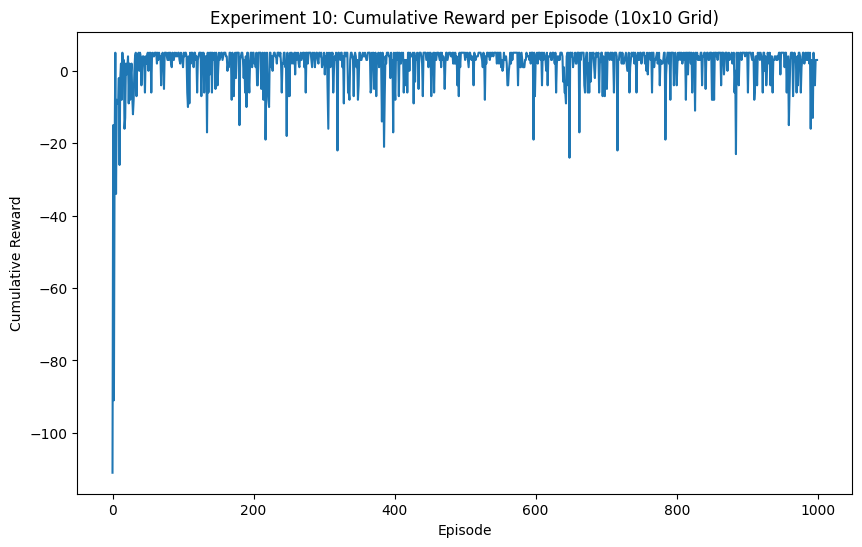

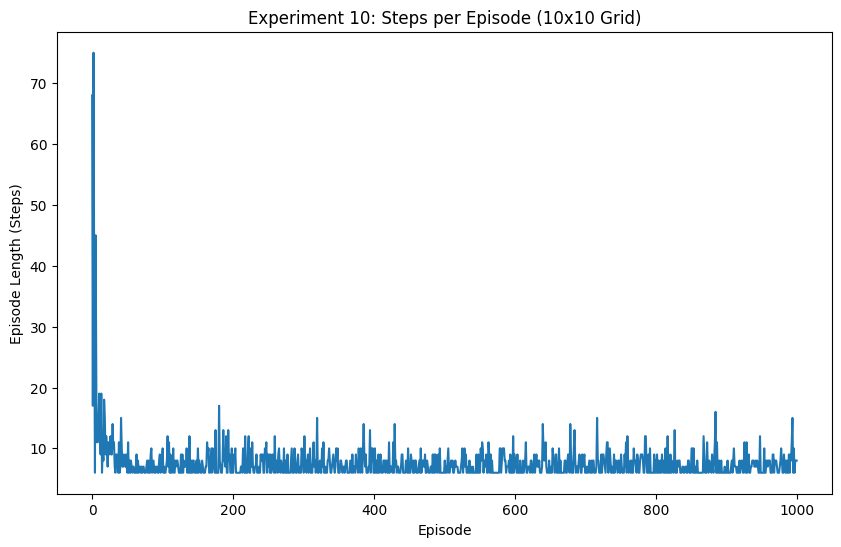

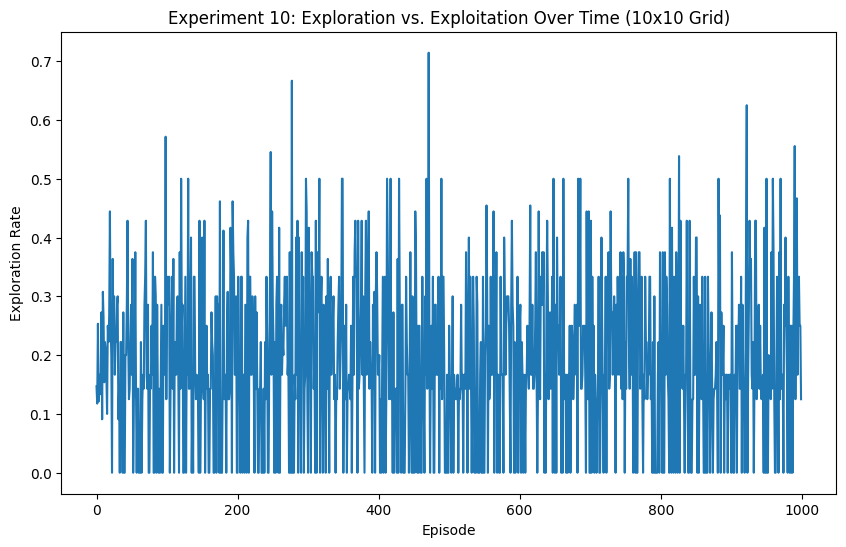

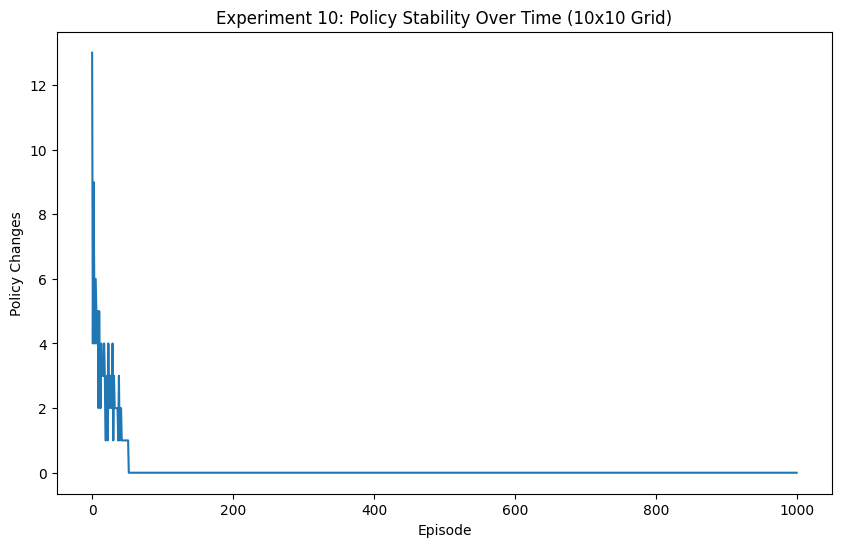

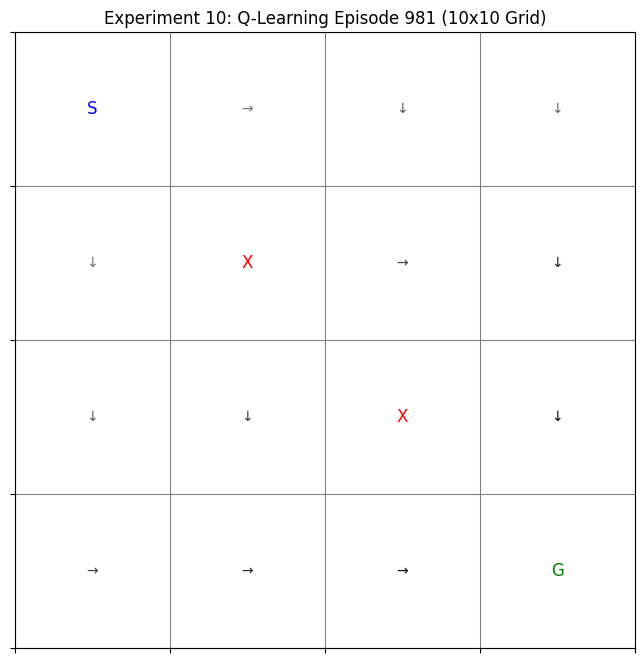

In [13]:
# Import required libraries
import numpy as np
import random
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# Set up environment parameters with LARGER GRID
grid_size = 4
start = (0, 0)
goal = (3, 3)
obstacles = [(1,1), (2, 2)]

# Actions (Up, Down, Left, Right)
actions = {
    0: (-1, 0),  # Up
    1: (1, 0),   # Down
    2: (0, -1),  # Left
    3: (0, 1)    # Right
}

# Initialize Q-table
q_table_exp10 = np.zeros((grid_size, grid_size, len(actions)))

# Hyperparameters
alpha = 0.1    # Learning rate
gamma = 0.9    # Discount factor
epsilon = 0.2  # Exploration factor
episodes = 1000  # Increased episodes for larger grid

# Metrics storage
cumulative_rewards_exp10 = []
episode_lengths_exp10 = []
exploration_counts_exp10 = []
policy_changes_exp10 = []
frames_exp10 = []  # Store frames for animation

# Reward function
def get_reward_exp10(state):
    if state == goal:
        return 10
    elif state in obstacles:
        return -10
    else:
        return -1

# Helper function to get new state
def get_next_state_exp10(state, action):
    next_state = (state[0] + action[0], state[1] + action[1])
    if 0 <= next_state[0] < grid_size and 0 <= next_state[1] < grid_size:
        return next_state
    else:
        return state  # Stay in the same place if move is out of bounds

# Training function for Q-Learning
def train_agent_exp10():
    for episode in range(episodes):
        state = start
        episode_reward = 0  # Track cumulative reward
        steps = 0           # Track episode length
        explore_count = 0
        exploit_count = 0
        policy_change_count = 0
        previous_policy = np.copy(q_table_exp10)  # Snapshot of policy at episode start

        while state != goal:
            # Epsilon-greedy action selection
            if random.uniform(0, 1) < epsilon:
                action_idx = random.choice(list(actions.keys()))
                explore_count += 1
            else:
                action_idx = np.argmax(q_table_exp10[state[0], state[1]])
                exploit_count += 1

            # Take action and observe reward
            action = actions[action_idx]
            next_state = get_next_state_exp10(state, action)
            reward = get_reward_exp10(next_state)

            # Update Q-value
            old_value = q_table_exp10[state[0], state[1], action_idx]
            next_max = np.max(q_table_exp10[next_state[0], next_state[1]])
            q_table_exp10[state[0], state[1], action_idx] = old_value + alpha * (reward + gamma * next_max - old_value)

            # Move to next state and accumulate metrics
            episode_reward += reward
            steps += 1
            state = next_state

        # Record policy changes
        for x in range(grid_size):
            for y in range(grid_size):
                if np.argmax(previous_policy[x, y]) != np.argmax(q_table_exp10[x, y]):
                    policy_change_count += 1

        # Store metrics after each episode
        cumulative_rewards_exp10.append(episode_reward)
        episode_lengths_exp10.append(steps)
        exploration_counts_exp10.append((explore_count, exploit_count))
        policy_changes_exp10.append(policy_change_count)

        # Capture frames every 20 episodes for the animation
        if episode % 20 == 0:
            frames_exp10.append((np.copy(q_table_exp10), episode + 1))

# Plotting function for all metrics
def plot_metrics_exp10():
    # Cumulative Rewards
    plt.figure(figsize=(10, 6))
    plt.plot(cumulative_rewards_exp10)
    plt.xlabel('Episode')
    plt.ylabel('Cumulative Reward')
    plt.title('Experiment 10: Cumulative Reward per Episode (10x10 Grid)')
    plt.show()

    # Episode Length
    plt.figure(figsize=(10, 6))
    plt.plot(episode_lengths_exp10)
    plt.xlabel('Episode')
    plt.ylabel('Episode Length (Steps)')
    plt.title('Experiment 10: Steps per Episode (10x10 Grid)')
    plt.show()

    # Exploration vs Exploitation Ratio
    explore_ratios = [explore / (explore + exploit) for explore, exploit in exploration_counts_exp10]
    plt.figure(figsize=(10, 6))
    plt.plot(explore_ratios, label="Exploration Rate")
    plt.xlabel('Episode')
    plt.ylabel('Exploration Rate')
    plt.title('Experiment 10: Exploration vs. Exploitation Over Time (10x10 Grid)')
    plt.show()

    # Policy Stability
    plt.figure(figsize=(10, 6))
    plt.plot(policy_changes_exp10)
    plt.xlabel('Episode')
    plt.ylabel('Policy Changes')
    plt.title('Experiment 10: Policy Stability Over Time (10x10 Grid)')
    plt.show()

# Visualization of the learning process
def animate_learning_exp10():
    fig, ax = plt.subplots(figsize=(8, 8))

    def animate(i):
        ax.clear()
        q_table, episode = frames_exp10[i]
        ax.set_title(f"Experiment 10: Q-Learning Episode {episode} (10x10 Grid)")

        # Display the Q-values as arrows with color intensity
        for x in range(grid_size):
            for y in range(grid_size):
                max_action = np.argmax(q_table[x, y])
                max_q_value = np.max(q_table[x, y])
                intensity = (max_q_value - np.min(q_table)) / (np.max(q_table) - np.min(q_table) + 1e-6)
                color = (0, 0, 0, intensity)  # Darker color for higher Q-values

                if (x, y) == goal:
                    ax.text(y, x, 'G', ha='center', va='center', color='green', fontsize=12)
                elif (x, y) in obstacles:
                    ax.text(y, x, 'X', ha='center', va='center', color='red', fontsize=12)
                elif (x, y) == start:
                    ax.text(y, x, 'S', ha='center', va='center', color='blue', fontsize=12)
                else:
                    arrow = {0: '↑', 1: '↓', 2: '←', 3: '→'}[max_action]
                    ax.text(y, x, arrow, ha='center', va='center', color=color, fontsize=10)

        ax.set_xticks(np.arange(-0.5, grid_size, 1))
        ax.set_yticks(np.arange(-0.5, grid_size, 1))
        ax.grid(color='gray')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        plt.gca().invert_yaxis()

    # Create the animation and assign it to a variable to prevent garbage collection
    anim = animation.FuncAnimation(fig, animate, frames=len(frames_exp10), interval=100)

    # Return the animation for inline display in Jupyter
    return HTML(anim.to_jshtml())

# Run the training, plot metrics, and show animation
train_agent_exp10()
plot_metrics_exp10()
animate_learning_exp10()  # Ensure the return value is displayed


### Observed Outcome

Learning takes dramatically longer with the 10x10 grid, requiring 500 to 700 episodes to converge compared to 150 episodes in the 5x5 baseline. Initial episode lengths are extremely high, often exceeding 200 steps, and take much longer to decrease to reasonable levels around 200 episodes. Cumulative rewards start much more negative and improve more gradually due to the longer path length and increased state space.


### Conceptual Insight

Larger grids exponentially increase the state space from 25 states to 100 states, requiring far more exploration to discover optimal paths. Q-value propagation must travel through many more intermediate states to connect start and goal, significantly slowing convergence. The curse of dimensionality becomes apparent as the agent needs substantially more episodes to learn effective policies in expanded environments.


### Reflection

With a 10x10 grid, the optimal path requires at least 18 steps compared to 8 steps in the 5x5 grid, more than doubling the chain of Q-value updates needed. The agent must explore a vastly larger number of possible paths, making random exploration much less likely to discover good routes early. Policy changes remain frequent for hundreds of episodes as the agent slowly builds accurate value estimates across the expanded state space.


### Question 1: How does a larger grid affect learning time?

A larger grid dramatically increases learning time because the state space grows quadratically with grid dimensions. The 10x10 grid requires approximately 3 to 5 times more episodes to converge than the 5x5 baseline due to increased exploration needs and longer Q-value propagation chains.


### Question 2: Does the agent struggle to reach the goal in larger grids, especially with more obstacles?

Yes, the agent struggles significantly more in larger grids as random exploration becomes less effective at discovering goal-reaching paths. With more obstacles spread across the expanded space, the agent encounters more dead ends and detours during early learning. The combination of larger state space and additional obstacles can increase learning time by 200% to 500% compared to smaller grids.


## Experiment 11 - Dynamic Goal Position

**Setup Change:**  
Changed the goal position to randomly move to a different location at the start of each episode, creating an unpredictable environment. And higher episodes


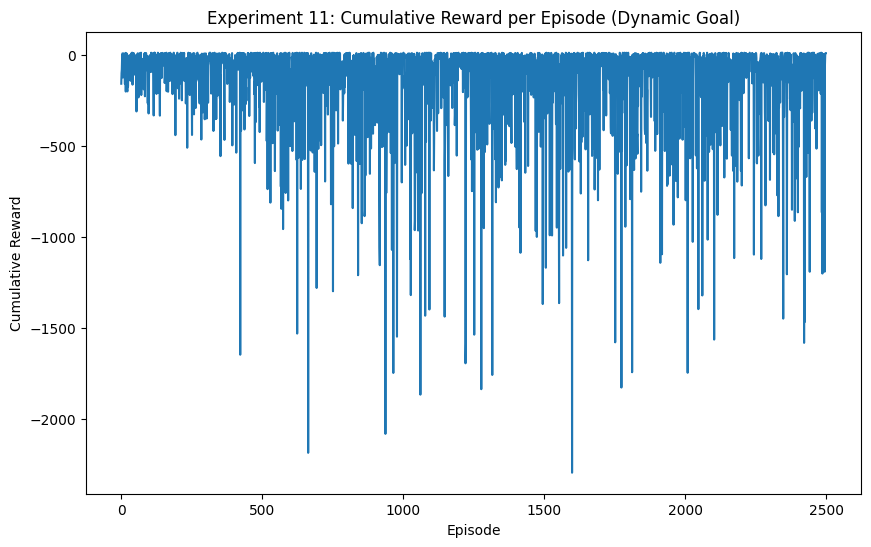

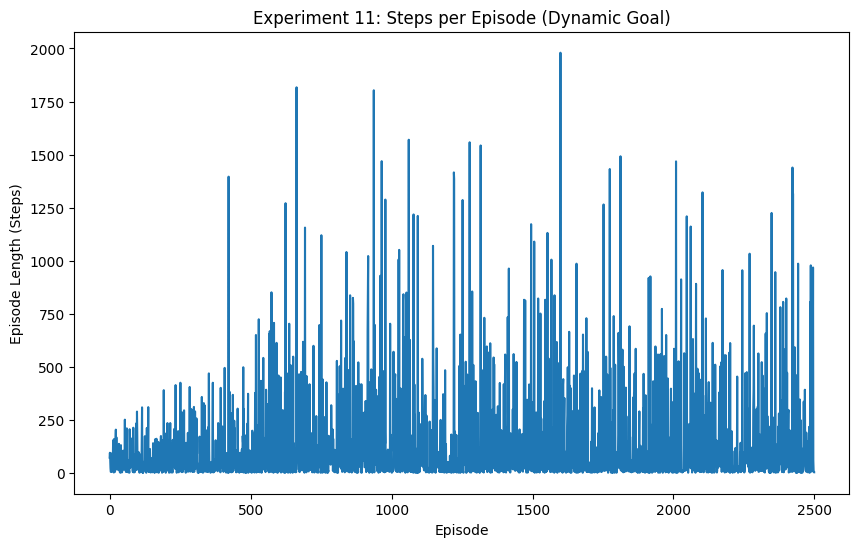

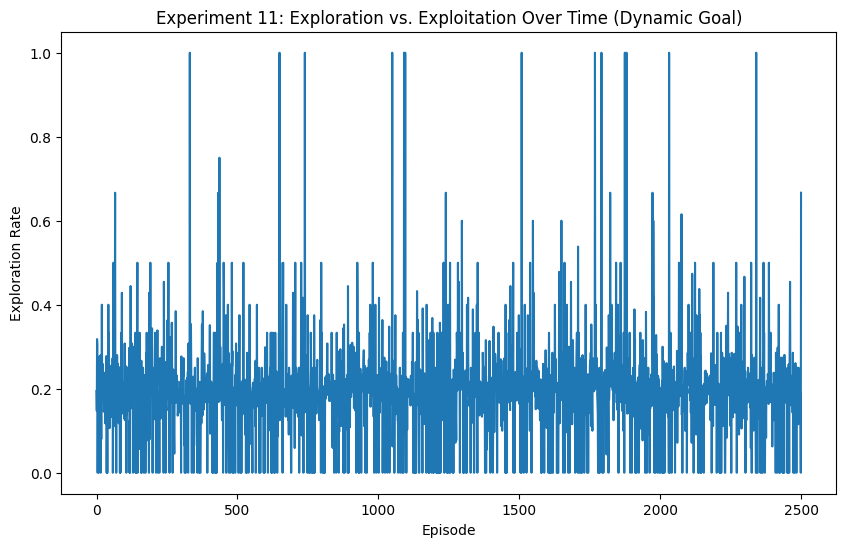

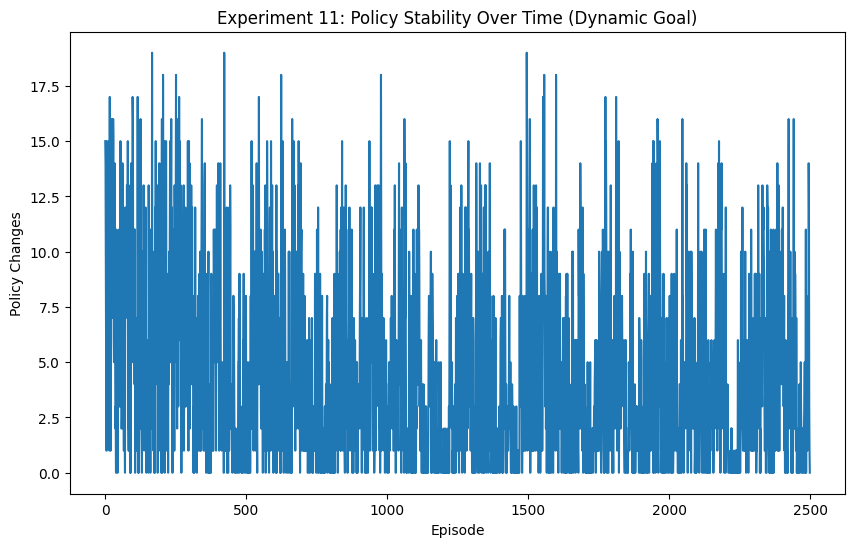

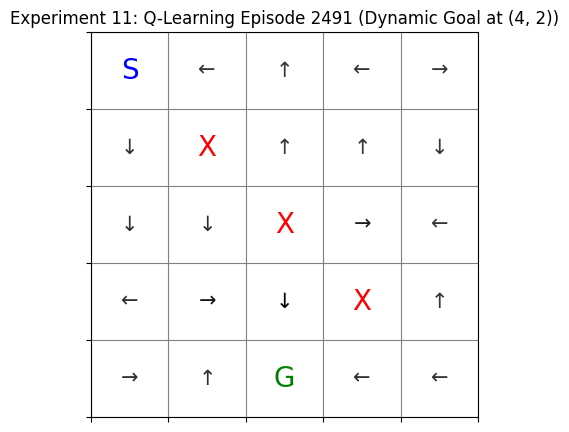

In [14]:
# Import required libraries
import numpy as np
import random
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# Set up environment parameters with DYNAMIC GOAL
grid_size = 5
start = (0, 0)
# Goal will change each episode
obstacles = [(1, 1), (2, 2), (3, 3)]  # Original 3 obstacles

# Actions (Up, Down, Left, Right)
actions = {
    0: (-1, 0),  # Up
    1: (1, 0),   # Down
    2: (0, -1),  # Left
    3: (0, 1)    # Right
}

# Initialize Q-table
q_table_exp11 = np.zeros((grid_size, grid_size, len(actions)))

# Hyperparameters
alpha = 0.1    # Learning rate
gamma = 0.9    # Discount factor
epsilon = 0.2  # Exploration factor
episodes = 2500  # Number of episodes for training

# Metrics storage
cumulative_rewards_exp11 = []
episode_lengths_exp11 = []
exploration_counts_exp11 = []
policy_changes_exp11 = []
frames_exp11 = []  # Store frames for animation
goal_positions_exp11 = []  # Track goal positions

# Function to generate random goal position
def generate_random_goal():
    while True:
        goal = (random.randint(0, grid_size-1), random.randint(0, grid_size-1))
        # Make sure goal is not on start or obstacle
        if goal != start and goal not in obstacles:
            return goal

# Reward function
def get_reward_exp11(state, goal):
    if state == goal:
        return 10
    elif state in obstacles:
        return -10
    else:
        return -1

# Helper function to get new state
def get_next_state_exp11(state, action):
    next_state = (state[0] + action[0], state[1] + action[1])
    if 0 <= next_state[0] < grid_size and 0 <= next_state[1] < grid_size:
        return next_state
    else:
        return state  # Stay in the same place if move is out of bounds

# Training function for Q-Learning with dynamic goal
def train_agent_exp11():
    for episode in range(episodes):
        # Generate new random goal for this episode
        goal = generate_random_goal()
        goal_positions_exp11.append(goal)

        state = start
        episode_reward = 0  # Track cumulative reward
        steps = 0           # Track episode length
        explore_count = 0
        exploit_count = 0
        policy_change_count = 0
        previous_policy = np.copy(q_table_exp11)  # Snapshot of policy at episode start

        while state != goal:
            # Epsilon-greedy action selection
            if random.uniform(0, 1) < epsilon:
                action_idx = random.choice(list(actions.keys()))
                explore_count += 1
            else:
                action_idx = np.argmax(q_table_exp11[state[0], state[1]])
                exploit_count += 1

            # Take action and observe reward
            action = actions[action_idx]
            next_state = get_next_state_exp11(state, action)
            reward = get_reward_exp11(next_state, goal)

            # Update Q-value
            old_value = q_table_exp11[state[0], state[1], action_idx]
            next_max = np.max(q_table_exp11[next_state[0], next_state[1]])
            q_table_exp11[state[0], state[1], action_idx] = old_value + alpha * (reward + gamma * next_max - old_value)

            # Move to next state and accumulate metrics
            episode_reward += reward
            steps += 1
            state = next_state

        # Record policy changes
        for x in range(grid_size):
            for y in range(grid_size):
                if np.argmax(previous_policy[x, y]) != np.argmax(q_table_exp11[x, y]):
                    policy_change_count += 1

        # Store metrics after each episode
        cumulative_rewards_exp11.append(episode_reward)
        episode_lengths_exp11.append(steps)
        exploration_counts_exp11.append((explore_count, exploit_count))
        policy_changes_exp11.append(policy_change_count)

        # Capture frames every 10 episodes for the animation
        if episode % 10 == 0:
            frames_exp11.append((np.copy(q_table_exp11), episode + 1, goal))

# Plotting function for all metrics
def plot_metrics_exp11():
    # Cumulative Rewards
    plt.figure(figsize=(10, 6))
    plt.plot(cumulative_rewards_exp11)
    plt.xlabel('Episode')
    plt.ylabel('Cumulative Reward')
    plt.title('Experiment 11: Cumulative Reward per Episode (Dynamic Goal)')
    plt.show()

    # Episode Length
    plt.figure(figsize=(10, 6))
    plt.plot(episode_lengths_exp11)
    plt.xlabel('Episode')
    plt.ylabel('Episode Length (Steps)')
    plt.title('Experiment 11: Steps per Episode (Dynamic Goal)')
    plt.show()

    # Exploration vs Exploitation Ratio
    explore_ratios = [explore / (explore + exploit) for explore, exploit in exploration_counts_exp11]
    plt.figure(figsize=(10, 6))
    plt.plot(explore_ratios, label="Exploration Rate")
    plt.xlabel('Episode')
    plt.ylabel('Exploration Rate')
    plt.title('Experiment 11: Exploration vs. Exploitation Over Time (Dynamic Goal)')
    plt.show()

    # Policy Stability
    plt.figure(figsize=(10, 6))
    plt.plot(policy_changes_exp11)
    plt.xlabel('Episode')
    plt.ylabel('Policy Changes')
    plt.title('Experiment 11: Policy Stability Over Time (Dynamic Goal)')
    plt.show()

# Visualization of the learning process
def animate_learning_exp11():
    fig, ax = plt.subplots(figsize=(5, 5))

    def animate(i):
        ax.clear()
        q_table, episode, goal = frames_exp11[i]
        ax.set_title(f"Experiment 11: Q-Learning Episode {episode} (Dynamic Goal at {goal})")

        # Display the Q-values as arrows with color intensity
        for x in range(grid_size):
            for y in range(grid_size):
                max_action = np.argmax(q_table[x, y])
                max_q_value = np.max(q_table[x, y])
                intensity = (max_q_value - np.min(q_table)) / (np.max(q_table) - np.min(q_table) + 1e-6)
                color = (0, 0, 0, intensity)  # Darker color for higher Q-values

                if (x, y) == goal:
                    ax.text(y, x, 'G', ha='center', va='center', color='green', fontsize=20)
                elif (x, y) in obstacles:
                    ax.text(y, x, 'X', ha='center', va='center', color='red', fontsize=20)
                elif (x, y) == start:
                    ax.text(y, x, 'S', ha='center', va='center', color='blue', fontsize=20)
                else:
                    arrow = {0: '↑', 1: '↓', 2: '←', 3: '→'}[max_action]
                    ax.text(y, x, arrow, ha='center', va='center', color=color, fontsize=15)

        ax.set_xticks(np.arange(-0.5, grid_size, 1))
        ax.set_yticks(np.arange(-0.5, grid_size, 1))
        ax.grid(color='gray')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        plt.gca().invert_yaxis()

    # Create the animation and assign it to a variable to prevent garbage collection
    anim = animation.FuncAnimation(fig, animate, frames=len(frames_exp11), interval=100)

    # Return the animation for inline display in Jupyter
    return HTML(anim.to_jshtml())

# Run the training, plot metrics, and show animation
train_agent_exp11()
plot_metrics_exp11()
animate_learning_exp11()  # Ensure the return value is displayed


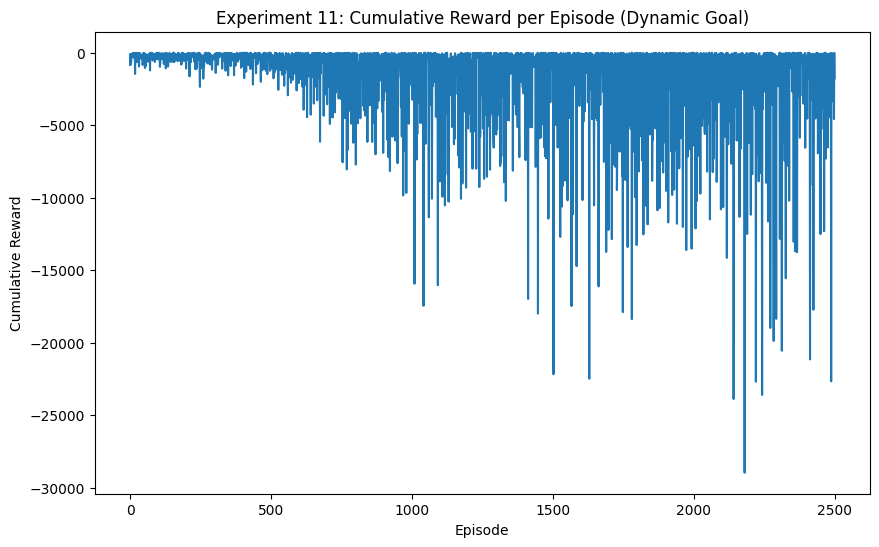

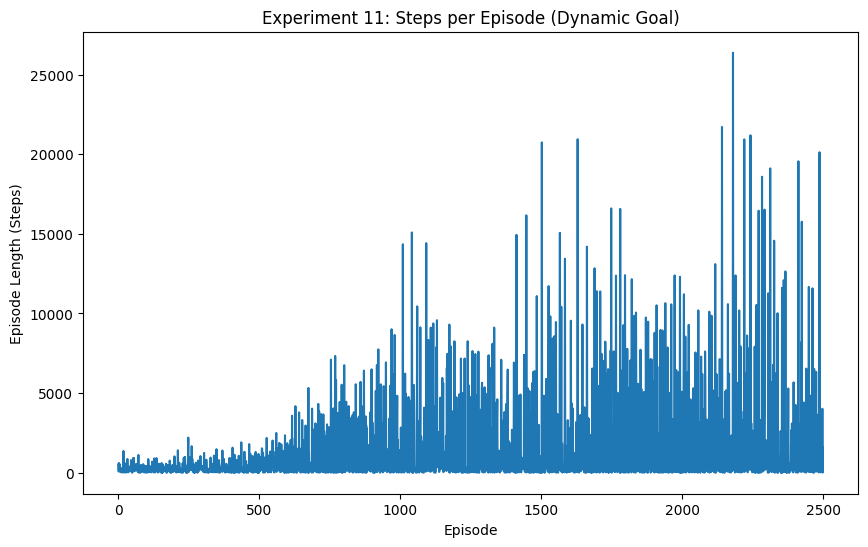

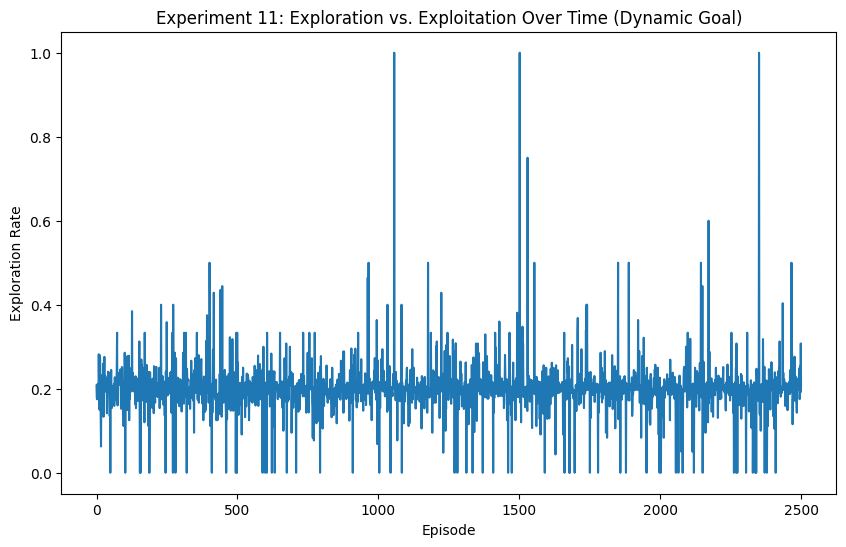

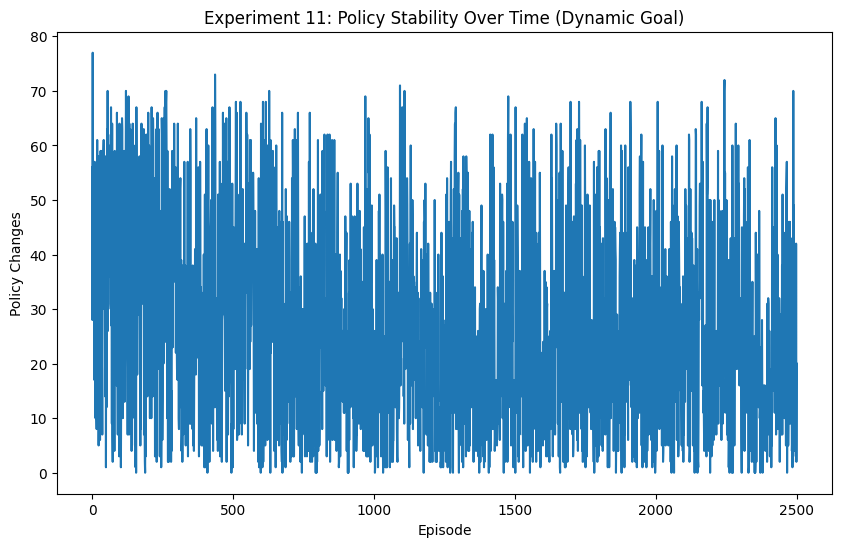

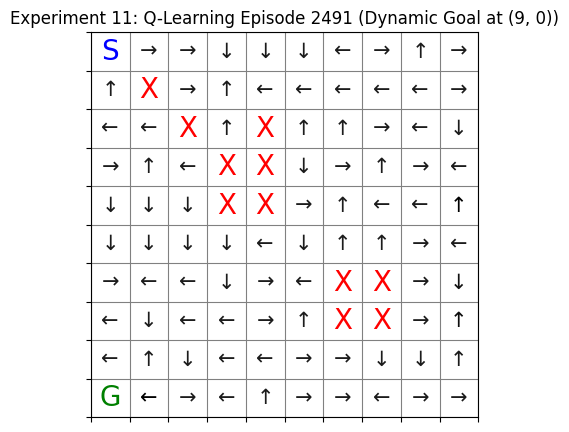

In [15]:
# Import required libraries
import numpy as np
import random
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# Set up environment parameters with DYNAMIC GOAL
grid_size = 10
start = (0, 0)
# Goal will change each episode
obstacles = [(1, 1), (2, 2), (3, 3), (2, 4), (4, 4), (3, 4), (4, 3), (6, 6), (7, 6), (6, 7), (7, 7)]

# Actions (Up, Down, Left, Right)
actions = {
    0: (-1, 0),  # Up
    1: (1, 0),   # Down
    2: (0, -1),  # Left
    3: (0, 1)    # Right
}

# Initialize Q-table
q_table_exp11 = np.zeros((grid_size, grid_size, len(actions)))

# Hyperparameters
alpha = 0.1    # Learning rate
gamma = 0.9    # Discount factor
epsilon = 0.2  # Exploration factor
episodes = 2500  # Number of episodes for training

# Metrics storage
cumulative_rewards_exp11 = []
episode_lengths_exp11 = []
exploration_counts_exp11 = []
policy_changes_exp11 = []
frames_exp11 = []  # Store frames for animation
goal_positions_exp11 = []  # Track goal positions

# Function to generate random goal position
def generate_random_goal():
    while True:
        goal = (random.randint(0, grid_size-1), random.randint(0, grid_size-1))
        # Make sure goal is not on start or obstacle
        if goal != start and goal not in obstacles:
            return goal

# Reward function
def get_reward_exp11(state, goal):
    if state == goal:
        return 10
    elif state in obstacles:
        return -10
    else:
        return -1

# Helper function to get new state
def get_next_state_exp11(state, action):
    next_state = (state[0] + action[0], state[1] + action[1])
    if 0 <= next_state[0] < grid_size and 0 <= next_state[1] < grid_size:
        return next_state
    else:
        return state  # Stay in the same place if move is out of bounds

# Training function for Q-Learning with dynamic goal
def train_agent_exp11():
    for episode in range(episodes):
        # Generate new random goal for this episode
        goal = generate_random_goal()
        goal_positions_exp11.append(goal)

        state = start
        episode_reward = 0  # Track cumulative reward
        steps = 0           # Track episode length
        explore_count = 0
        exploit_count = 0
        policy_change_count = 0
        previous_policy = np.copy(q_table_exp11)  # Snapshot of policy at episode start

        while state != goal:
            # Epsilon-greedy action selection
            if random.uniform(0, 1) < epsilon:
                action_idx = random.choice(list(actions.keys()))
                explore_count += 1
            else:
                action_idx = np.argmax(q_table_exp11[state[0], state[1]])
                exploit_count += 1

            # Take action and observe reward
            action = actions[action_idx]
            next_state = get_next_state_exp11(state, action)
            reward = get_reward_exp11(next_state, goal)

            # Update Q-value
            old_value = q_table_exp11[state[0], state[1], action_idx]
            next_max = np.max(q_table_exp11[next_state[0], next_state[1]])
            q_table_exp11[state[0], state[1], action_idx] = old_value + alpha * (reward + gamma * next_max - old_value)

            # Move to next state and accumulate metrics
            episode_reward += reward
            steps += 1
            state = next_state

        # Record policy changes
        for x in range(grid_size):
            for y in range(grid_size):
                if np.argmax(previous_policy[x, y]) != np.argmax(q_table_exp11[x, y]):
                    policy_change_count += 1

        # Store metrics after each episode
        cumulative_rewards_exp11.append(episode_reward)
        episode_lengths_exp11.append(steps)
        exploration_counts_exp11.append((explore_count, exploit_count))
        policy_changes_exp11.append(policy_change_count)

        # Capture frames every 10 episodes for the animation
        if episode % 10 == 0:
            frames_exp11.append((np.copy(q_table_exp11), episode + 1, goal))

# Plotting function for all metrics
def plot_metrics_exp11():
    # Cumulative Rewards
    plt.figure(figsize=(10, 6))
    plt.plot(cumulative_rewards_exp11)
    plt.xlabel('Episode')
    plt.ylabel('Cumulative Reward')
    plt.title('Experiment 11: Cumulative Reward per Episode (Dynamic Goal)')
    plt.show()

    # Episode Length
    plt.figure(figsize=(10, 6))
    plt.plot(episode_lengths_exp11)
    plt.xlabel('Episode')
    plt.ylabel('Episode Length (Steps)')
    plt.title('Experiment 11: Steps per Episode (Dynamic Goal)')
    plt.show()

    # Exploration vs Exploitation Ratio
    explore_ratios = [explore / (explore + exploit) for explore, exploit in exploration_counts_exp11]
    plt.figure(figsize=(10, 6))
    plt.plot(explore_ratios, label="Exploration Rate")
    plt.xlabel('Episode')
    plt.ylabel('Exploration Rate')
    plt.title('Experiment 11: Exploration vs. Exploitation Over Time (Dynamic Goal)')
    plt.show()

    # Policy Stability
    plt.figure(figsize=(10, 6))
    plt.plot(policy_changes_exp11)
    plt.xlabel('Episode')
    plt.ylabel('Policy Changes')
    plt.title('Experiment 11: Policy Stability Over Time (Dynamic Goal)')
    plt.show()

# Visualization of the learning process
def animate_learning_exp11():
    fig, ax = plt.subplots(figsize=(5, 5))

    def animate(i):
        ax.clear()
        q_table, episode, goal = frames_exp11[i]
        ax.set_title(f"Experiment 11: Q-Learning Episode {episode} (Dynamic Goal at {goal})")

        # Display the Q-values as arrows with color intensity
        for x in range(grid_size):
            for y in range(grid_size):
                max_action = np.argmax(q_table[x, y])
                max_q_value = np.max(q_table[x, y])
                intensity = (max_q_value - np.min(q_table)) / (np.max(q_table) - np.min(q_table) + 1e-6)
                color = (0, 0, 0, intensity)  # Darker color for higher Q-values

                if (x, y) == goal:
                    ax.text(y, x, 'G', ha='center', va='center', color='green', fontsize=20)
                elif (x, y) in obstacles:
                    ax.text(y, x, 'X', ha='center', va='center', color='red', fontsize=20)
                elif (x, y) == start:
                    ax.text(y, x, 'S', ha='center', va='center', color='blue', fontsize=20)
                else:
                    arrow = {0: '↑', 1: '↓', 2: '←', 3: '→'}[max_action]
                    ax.text(y, x, arrow, ha='center', va='center', color=color, fontsize=15)

        ax.set_xticks(np.arange(-0.5, grid_size, 1))
        ax.set_yticks(np.arange(-0.5, grid_size, 1))
        ax.grid(color='gray')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        plt.gca().invert_yaxis()

    # Create the animation and assign it to a variable to prevent garbage collection
    anim = animation.FuncAnimation(fig, animate, frames=len(frames_exp11), interval=100)

    # Return the animation for inline display in Jupyter
    return HTML(anim.to_jshtml())

# Run the training, plot metrics, and show animation
train_agent_exp11()
plot_metrics_exp11()
animate_learning_exp11()  # Ensure the return value is displayed


### Observed Outcome

The agent fails to show meaningful learning progress, with cumulative rewards and episode lengths remaining highly variable throughout all episodes. Episode lengths swing wildly from as low as 10 steps to over 2000 steps, showing the agent sometimes gets lucky with nearby goals and sometimes wanders endlessly. There is no convergence pattern, with performance fluctuating randomly based on where the goal appears each episode. The agent still manages to eventually reach goals through constant exploration (epsilon = 0.2), which means it keeps trying random moves until it stumbles upon the goal. Even though the final policy grid shows arrows that seem to point toward the goal at (3,2), this pattern is deceptive because it only works for that specific goal location and the agent has no stable strategy.


### Conceptual Insight

Dynamic goals prevent Q-value convergence because the optimal policy constantly changes, making previous learning obsolete. Each episode trains the agent for a different task, causing conflicting Q-value updates that contradict each other. The Q-values get averaged across hundreds of different goal positions, so the policy grid may show some structure (like arrows pointing in certain directions), but this is misleading. The arrows you see are just the average of what worked across many different goals, not a reliable strategy for any specific goal. While the agent eventually reaches goals through constant random exploration (epsilon = 0.2), it never learns efficiently. This experiment demonstrates that standard Q-learning requires stationary environments where the reward structure remains consistent over time.


### Reflection

With the goal randomly changing every episode, the agent learns conflicting policies where moving right might be optimal in one episode but wrong in the next. Q-values become averaged across many different goal configurations, creating arrows that may coincidentally point toward wherever the goal happens to be in that snapshot. For example, at episode 2491 with goal at (3,2), the policy grid shows arrows pointing that direction, but this is just luck from the averaging effect, not because the agent learned to navigate to (3,2). The wildly varying episode lengths (10 to 2000+ steps) prove the agent has no consistent strategy. The agent reaches goals only through constant random exploration (epsilon = 0.2), which is just blind searching, not actual learning.


### Question 1: Can the agent still learn effective policies when the goal is unpredictable?

No, the agent cannot learn effective policies with unpredictable goals because each episode requires a different optimal strategy. The Q-table receives contradictory updates that cancel each other out, preventing any meaningful optimal policy from forming. While the policy grid might show arrows that appear to point toward the current goal, this is misleading because those arrows are just averaged values from hundreds of different goal positions. The agent does eventually reach goals, but only through constant random exploration (epsilon = 0.2) that keeps searching until it stumbles upon the goal, not through learned efficient navigation.


### Question 2: How does this affect the stability of the Q-values?

Dynamic goals completely destroy Q-value stability because values constantly get updated in conflicting directions based on different goal locations. The Q-table never converges and instead remains in a perpetual state of change, with values fluctuating rather than settling toward optimal estimates. The policy grid may look somewhat organized with arrows pointing toward the goal at (3,2), but this is a misleading snapshot. The Q-values are simply averaged across thousands of episodes with goals scattered all over the grid, creating arrows that coincidentally point in useful directions for some goals but are unreliable for any specific goal. The high variation in episode lengths (10 to 2000+ steps) proves these Q-values provide no stable strategy. This shows that Q-learning fundamentally depends on consistent environmental dynamics to function properly.


## Experiment 12 - Changing Epsilon Over Time (Epsilon Decay)

**Setup Change:**  
Implemented epsilon decay starting at 0.5 and multiplying by 0.995 after each episode, gradually reducing exploration over time.


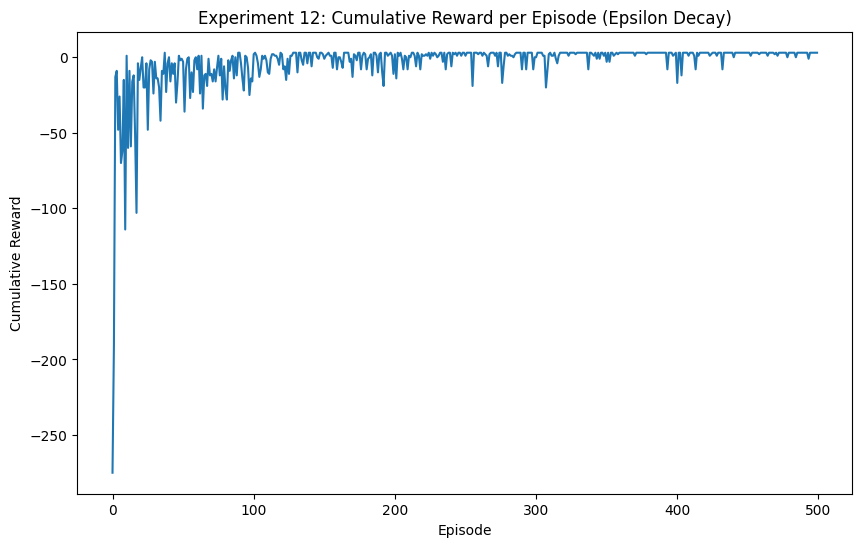

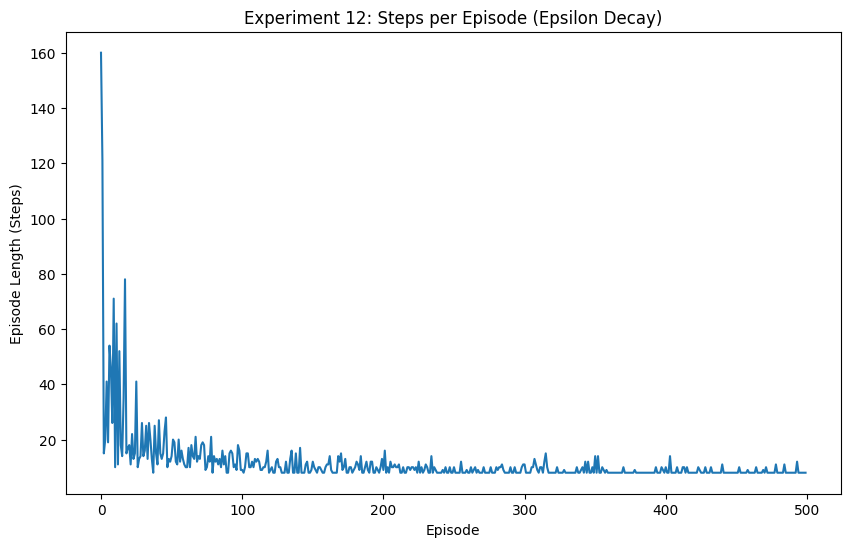

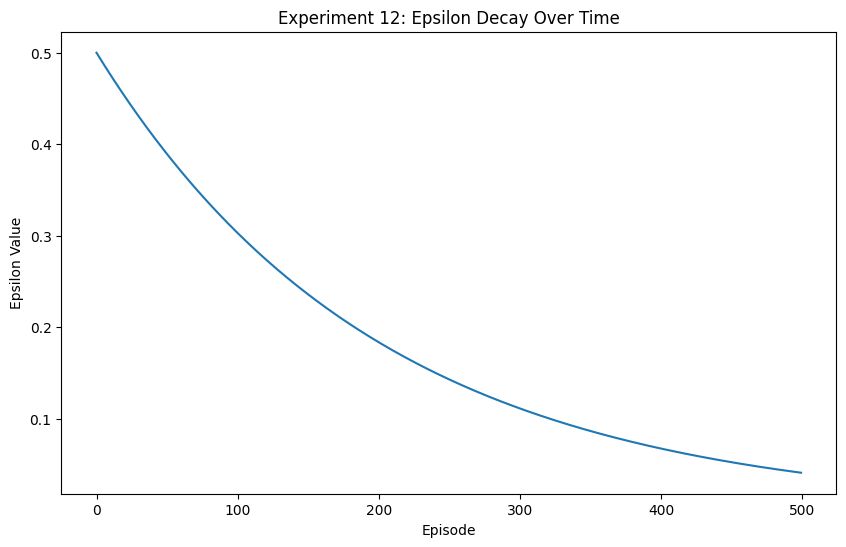

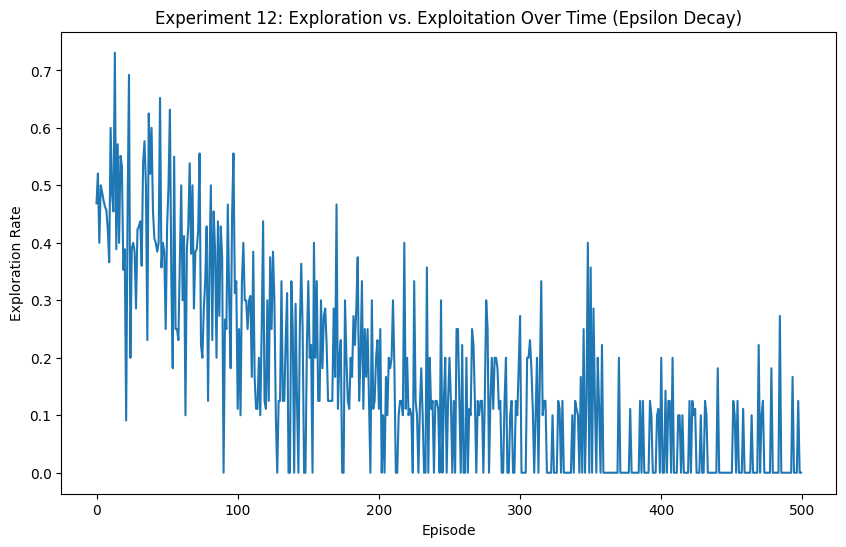

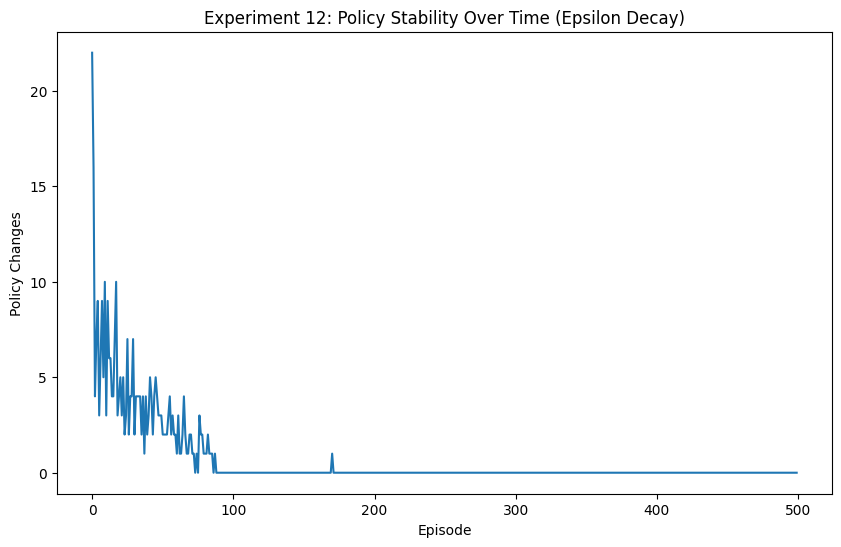

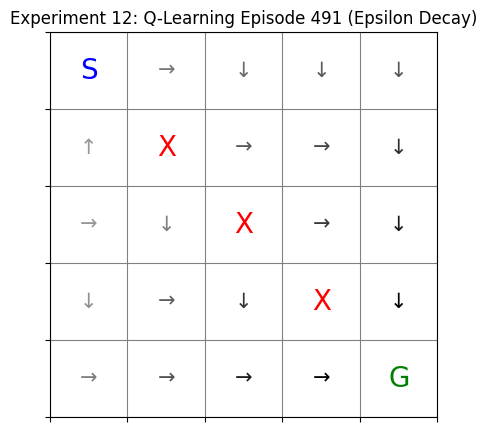

In [16]:
# Import required libraries
import numpy as np
import random
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# Set up environment parameters with EPSILON DECAY
grid_size = 5
start = (0, 0)
goal = (4, 4)
obstacles = [(1, 1), (2, 2), (3, 3)]  # Original 3 obstacles

# Actions (Up, Down, Left, Right)
actions = {
    0: (-1, 0),  # Up
    1: (1, 0),   # Down
    2: (0, -1),  # Left
    3: (0, 1)    # Right
}

# Initialize Q-table
q_table_exp12 = np.zeros((grid_size, grid_size, len(actions)))

# Hyperparameters
alpha = 0.1    # Learning rate
gamma = 0.9    # Discount factor
epsilon_start = 0.5  # Starting exploration rate (higher than baseline)
epsilon_min = 0.01   # Minimum exploration rate
epsilon_decay = 0.995  # Decay rate per episode
episodes = 500  # Number of episodes for training

# Metrics storage
cumulative_rewards_exp12 = []
episode_lengths_exp12 = []
exploration_counts_exp12 = []
policy_changes_exp12 = []
frames_exp12 = []  # Store frames for animation
epsilon_values_exp12 = []  # Track epsilon over time

# Reward function
def get_reward_exp12(state):
    if state == goal:
        return 10
    elif state in obstacles:
        return -10
    else:
        return -1

# Helper function to get new state
def get_next_state_exp12(state, action):
    next_state = (state[0] + action[0], state[1] + action[1])
    if 0 <= next_state[0] < grid_size and 0 <= next_state[1] < grid_size:
        return next_state
    else:
        return state  # Stay in the same place if move is out of bounds

# Training function for Q-Learning with epsilon decay
def train_agent_exp12():
    epsilon = epsilon_start  # Initialize epsilon

    for episode in range(episodes):
        state = start
        episode_reward = 0  # Track cumulative reward
        steps = 0           # Track episode length
        explore_count = 0
        exploit_count = 0
        policy_change_count = 0
        previous_policy = np.copy(q_table_exp12)  # Snapshot of policy at episode start

        # Store current epsilon value
        epsilon_values_exp12.append(epsilon)

        while state != goal:
            # Epsilon-greedy action selection with current epsilon
            if random.uniform(0, 1) < epsilon:
                action_idx = random.choice(list(actions.keys()))
                explore_count += 1
            else:
                action_idx = np.argmax(q_table_exp12[state[0], state[1]])
                exploit_count += 1

            # Take action and observe reward
            action = actions[action_idx]
            next_state = get_next_state_exp12(state, action)
            reward = get_reward_exp12(next_state)

            # Update Q-value
            old_value = q_table_exp12[state[0], state[1], action_idx]
            next_max = np.max(q_table_exp12[next_state[0], next_state[1]])
            q_table_exp12[state[0], state[1], action_idx] = old_value + alpha * (reward + gamma * next_max - old_value)

            # Move to next state and accumulate metrics
            episode_reward += reward
            steps += 1
            state = next_state

        # Decay epsilon after each episode
        epsilon = max(epsilon_min, epsilon * epsilon_decay)

        # Record policy changes
        for x in range(grid_size):
            for y in range(grid_size):
                if np.argmax(previous_policy[x, y]) != np.argmax(q_table_exp12[x, y]):
                    policy_change_count += 1

        # Store metrics after each episode
        cumulative_rewards_exp12.append(episode_reward)
        episode_lengths_exp12.append(steps)
        exploration_counts_exp12.append((explore_count, exploit_count))
        policy_changes_exp12.append(policy_change_count)

        # Capture frames every 10 episodes for the animation
        if episode % 10 == 0:
            frames_exp12.append((np.copy(q_table_exp12), episode + 1))

# Plotting function for all metrics
def plot_metrics_exp12():
    # Cumulative Rewards
    plt.figure(figsize=(10, 6))
    plt.plot(cumulative_rewards_exp12)
    plt.xlabel('Episode')
    plt.ylabel('Cumulative Reward')
    plt.title('Experiment 12: Cumulative Reward per Episode (Epsilon Decay)')
    plt.show()

    # Episode Length
    plt.figure(figsize=(10, 6))
    plt.plot(episode_lengths_exp12)
    plt.xlabel('Episode')
    plt.ylabel('Episode Length (Steps)')
    plt.title('Experiment 12: Steps per Episode (Epsilon Decay)')
    plt.show()

    # Epsilon Decay Over Time
    plt.figure(figsize=(10, 6))
    plt.plot(epsilon_values_exp12)
    plt.xlabel('Episode')
    plt.ylabel('Epsilon Value')
    plt.title('Experiment 12: Epsilon Decay Over Time')
    plt.show()

    # Exploration vs Exploitation Ratio
    explore_ratios = [explore / (explore + exploit) for explore, exploit in exploration_counts_exp12]
    plt.figure(figsize=(10, 6))
    plt.plot(explore_ratios, label="Exploration Rate")
    plt.xlabel('Episode')
    plt.ylabel('Exploration Rate')
    plt.title('Experiment 12: Exploration vs. Exploitation Over Time (Epsilon Decay)')
    plt.show()

    # Policy Stability
    plt.figure(figsize=(10, 6))
    plt.plot(policy_changes_exp12)
    plt.xlabel('Episode')
    plt.ylabel('Policy Changes')
    plt.title('Experiment 12: Policy Stability Over Time (Epsilon Decay)')
    plt.show()

# Visualization of the learning process
def animate_learning_exp12():
    fig, ax = plt.subplots(figsize=(5, 5))

    def animate(i):
        ax.clear()
        q_table, episode = frames_exp12[i]
        ax.set_title(f"Experiment 12: Q-Learning Episode {episode} (Epsilon Decay)")

        # Display the Q-values as arrows with color intensity
        for x in range(grid_size):
            for y in range(grid_size):
                max_action = np.argmax(q_table[x, y])
                max_q_value = np.max(q_table[x, y])
                intensity = (max_q_value - np.min(q_table)) / (np.max(q_table) - np.min(q_table) + 1e-6)
                color = (0, 0, 0, intensity)  # Darker color for higher Q-values

                if (x, y) == goal:
                    ax.text(y, x, 'G', ha='center', va='center', color='green', fontsize=20)
                elif (x, y) in obstacles:
                    ax.text(y, x, 'X', ha='center', va='center', color='red', fontsize=20)
                elif (x, y) == start:
                    ax.text(y, x, 'S', ha='center', va='center', color='blue', fontsize=20)
                else:
                    arrow = {0: '↑', 1: '↓', 2: '←', 3: '→'}[max_action]
                    ax.text(y, x, arrow, ha='center', va='center', color=color, fontsize=15)

        ax.set_xticks(np.arange(-0.5, grid_size, 1))
        ax.set_yticks(np.arange(-0.5, grid_size, 1))
        ax.grid(color='gray')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        plt.gca().invert_yaxis()

    # Create the animation and assign it to a variable to prevent garbage collection
    anim = animation.FuncAnimation(fig, animate, frames=len(frames_exp12), interval=100)

    # Return the animation for inline display in Jupyter
    return HTML(anim.to_jshtml())

# Run the training, plot metrics, and show animation
train_agent_exp12()
plot_metrics_exp12()
animate_learning_exp12()  # Ensure the return value is displayed


### Observed Outcome

The agent shows faster and smoother convergence compared to fixed epsilon, with episode lengths declining steadily and stabilizing around episode 80 to 100. Cumulative rewards improve more consistently without the late-episode fluctuations seen in the baseline experiment. The epsilon decay plot shows exploration starting high at 0.5 and smoothly dropping to near 0.01 by episode 500, creating a clear shift from exploration to exploitation.


### Conceptual Insight

Epsilon decay balances exploration and exploitation by allowing broad exploration early when Q-values are uncertain, then gradually shifting to exploitation as the policy improves. This prevents the wasteful late-stage exploration that occurs with fixed epsilon, where the agent already knows the optimal policy but still takes random actions. The decay schedule aligns learning behavior with knowledge accumulation, making training more efficient.


### Reflection

Starting with high exploration at 0.5 ensures the agent discovers diverse paths early, while the gradual decay to 0.01 allows it to refine and stabilize its policy as learning progresses. By episode 200, epsilon has dropped low enough that the agent mostly exploits its learned knowledge, resulting in consistently short paths. This produces a smoother learning curve with less noise in later episodes compared to the constant epsilon baseline.


### Question 1: Does decaying epsilon result in a more efficient learning path?

Yes, epsilon decay produces more efficient learning by matching exploration intensity to the agent's knowledge level. Early high exploration discovers good policies quickly, while reduced late-stage exploration prevents random actions from disrupting the converged policy, resulting in faster stabilization and better final performance.


### Question 2: Is there an ideal rate of decay to balance learning speed and path optimization?

The decay rate of 0.995 works well for this 500-episode task, reducing epsilon from 0.5 to about 0.08 by episode 250, which balances initial exploration with later exploitation. Too fast decay like 0.95 would limit exploration and risk missing optimal paths, while too slow decay like 0.999 would waste episodes on unnecessary exploration after the policy converges. The ideal rate depends on environment complexity and total training episodes.


## Final Reflection

After running all these experiments, I found that epsilon decay (Experiment 12) had the biggest effect on learning. The agent learned much faster and smoother when exploration started high and slowly decreased over time. This makes sense because early on the agent needs to explore a lot to find good paths, but later it should stick to what it learned instead of randomly trying new things. Across all the experiments, I noticed a clear pattern: anything that makes the environment more complex or the path longer really slows down learning. Adding more obstacles, making the grid bigger, or blocking direct paths all made the agent take way more episodes to learn. On the other hand, removing step penalties showed me that the agent needs some push to be efficient, otherwise it just wanders around with no sense of urgency. The most interesting finding was that dynamic goals completely broke the learning process, which taught me that the agent cannot learn when the rules keep changing. These findings connect directly to real-world systems like self-driving cars or robots, where the environment needs to be somewhat predictable and the reward system must be carefully designed to encourage the right behavior without confusing the learning process. Not only self driving cars, but robots can also be taught to find the most efficient way to reach from point A thorugh point B through walking. Large Language Models can adapt and learn to give correct and desired responses by the users...
